In [11]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
import time
import xlsxwriter

from datetime import datetime
from matplotlib_scalebar.scalebar import ScaleBar
from scipy.ndimage.interpolation import rotate
from skimage.restoration import denoise_nl_means, estimate_sigma #, denoise_bilateral
from skimage import morphology

C:\Users\ppak1\AppData\Local\Temp\ipykernel_26968\3226484588.py:10: DeprecationWarning: Please use `rotate` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  from scipy.ndimage.interpolation import rotate


In [12]:
path = './images/original'

begin = time.time()
row = 0
column = 0
files = os.listdir(path)
images = [" " for k in range(len(files))]
Thick_table = np.zeros(len(files))
mean_intercept = np.zeros(len(files))
mean_inv_intercept=np.zeros(len(files))
mean_in=np.zeros(len(files))
frac=np.zeros(len(files))

workbook = xlsxwriter.Workbook('T.xlsx') 
worksheet = workbook.add_worksheet()

In [13]:
# distance in pixel on the scale bar
distance_in_pixel=187

# distance mentioned on the scale bar in um
distance_in_micrometer=10

# Text file name for storing the variable details
Variable_name='Ak_run_3'

# Type of adaptive thresholding to be applied. Choose from cv2.ADAPTIVE_THRESH_MEAN_C or cv2.ADAPTIVE_THRESH_GAUSSIAN_C
Thresholding="cv2.ADAPTIVE_THRESH_GAUSSIAN_C"

# Angle step size to facilitate the degree of rotation.    
ang_size=180

# Median Filter size to be used
median_filter=3

# Adaptive thresholding filter size to be used
adpt_thresh_filter=11

# Adaptive thresholding block constant to be subtracted
adpt_thresh_const=1.5

# Denoise filter h, denoise template window size and denoise search window size 
DeNoise_h,DeNoise_template_window_size,DeNoise_search_window_size=2,3,3

# kernal size to be used by morphological filters
kernal_a,kernal_b=3,3

# Small object : Remove objects smaller than the specified size.
small_objects_min_size=2
    

In [14]:

def measure_lath(file,ang_step):

    #img = Image.open(file).convert('L') # converting to grayscale
    img11 = cv2.imread(file,0)
    img11_arr = np.array(img11)     
    plt.figure(figsize=(10,10))
    plt.title('Primary Image')
    plt.imshow(img11_arr)
    plt.savefig('primary_img.Tif', format='Tif')
    plt.colorbar()
    plt.show()
    Height_1=0#6-Univ.of Manchester
    width_1=0
    width_2= 1280#1024-Univ.of Manchester;1024-rjlee
    Height_2=960#1024-Univ.of Manchester;1030-rjlee
    img1= img11[Height_1:Height_2,width_1:width_2]
    img1_arr=np.array(img1)
    hyp=(((img1_arr.shape[0])**(2))+((img1_arr.shape[1])**(2)))**(0.5)
    print(hyp)
    plt.figure(figsize=(10,10))
    plt.title('Cropped Image')
    plt.imshow(img1_arr)
    plt.savefig('Cropped_img.Tif', format='Tif')
    plt.colorbar()
    plt.show()
    print (img1_arr)
    max_value = np.max(img1_arr)
    min_value = np.min(img1_arr)
    img1_inv = ~img1_arr  # invert B&W img=-img if we have to calculate the white spacings ---> use img = ~img for alpha lath thickness and img =img for beta thickness
    plt.hist(img1_inv.flat, bins=100, range=(0,255))
    print (max_value)
    print (min_value)
    sigma_est=np.mean(estimate_sigma(img1_inv, multichannel = True))
    nlm=denoise_nl_means(img1_inv,h=1.15*sigma_est,fast_mode=True,patch_size=5,patch_distance=3,multichannel=False,preserve_range=True).astype('uint8')
    plt.figure(figsize=(10,10))
    plt.title('Skde')
    plt.imshow(nlm)
    plt.savefig('Skde_img.Tif', format='Tif')
    plt.colorbar()
    plt.show()
    counts,bins,mm=plt.hist(nlm.flat, bins=100, range=(0,255))
    img1_blur = cv2.medianBlur(nlm,3)  # usually varies between 3,5,7.
    plt.figure(figsize=(10,10))
    plt.title('Noise Reduced Image')
    plt.imshow(img1_blur)
    plt.savefig('Noise_red.Tif', format='Tif')
    plt.colorbar()
    plt.show() 
    img1_thresh = cv2.adaptiveThreshold(img1_blur,1,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,2.5) # Other option is using cv2.ADAPTIVE_THRESH_GAUSSIAN_C ; cv2.ADAPTIVE_THRESH_MEAN_C
    kernel=np.ones((3,3),np.uint8)
    plt.figure(figsize=(10,10))
    plt.title('Threshold Image')
    plt.imshow(img1_thresh)
    plt.savefig('Thresholded_img.png',dpi= 300, format='png')
    plt.show()
# =============================================================================
    dst = cv2.fastNlMeansDenoising(img1_thresh,None,2,3,3)
#    # fastNlMeansDenoising(src, dst, h, templateWindowSize, searchWindowSize)
#                 # h: Parameter regulating filter strength. Big "h" value perfectly removes noise 
#                 # but also removes image details, smaller "h" value preserves details but also preserves some noise
#     
    plt.figure(figsize=(10,10))
    plt.title('Denoise Threshold Image')
    plt.imshow(dst)
    plt.savefig('Denoise Thresholded_img.Tif',dpi= 300, format='Tif')
    plt.show()
    plt.hist(img1_thresh.flat, bins=100, range=(0,1)) 
    opening =cv2.morphologyEx(dst, cv2.MORPH_OPEN, kernel)
    plt.hist(opening.flat, bins=100) 
    opening = opening > 0
    dst1 = morphology.remove_small_objects(opening, min_size= 2)
    dst= morphology.remove_small_holes(dst1,area_threshold=55, connectivity=1) 
    fig=plt.figure(frameon=False)
    fig.set_size_inches(7.01,7.01)
    plt.axis('off')
    plt.imshow(dst)
    scalebar = ScaleBar(0.054054054, "um", box_color = None)
    plt.gca().add_artist(scalebar)
    
    plt.savefig('Remove_small_Holes.png',dpi=300, format='png')
    plt.show
    dst_arr=np.array(dst)
    np_img= np.array(img1_thresh)
    print(np_img)
    print (img1_thresh.shape)

    
    #img1_thresh=img1_thresh[:,1:] # If the image size is odd : like 1767 * 2400 or something then write it as img1_thresh=img1_thresh[1:,:]
    dst_thresh=dst[:,:]    
    #print (img1_thresh.shape)
    print (dst_thresh.shape)
    shp = np.array(img1_thresh.shape)//2 
    print (shp)
    tpix= (2*2*shp[0]*shp[1])
    print (tpix)
    pix=(2*shp[1])
    print (pix)
    shape = [2048,2048] # calculate the canvas size by calculating hypotenuse of the image size.
    dst_arr = np.zeros(shape) # canvas 
    dst_arr[shape[0]//2-shp[0]:shape[0]//2+shp[0],shape[1]//2-shp[1]:shape[1]//2+shp[1]] = dst_thresh
    
    plt.figure(figsize=(10,10))
    plt.imshow(dst_arr)
    plt.savefig('Thresholded_img_padded.Tif', format='Tif')
    plt.show()
    avg_dist = []
    avg_invd = []
    avg_afrac = []
    distance1 = []
    indis1=[]
    a_avg_afrac=[]
    b_frac=[]

    
    for angle in np.arange(0,180,ang_step): #for any step size varying from 0 to 360
        display_img = rotate(dst_arr,angle,order=0)
        display_img = display_img[display_img.shape[0]//2-shape[0]//2:display_img.shape[0]//2+shape[0]//2,
                        display_img.shape[1]//2-shape[1]//2:display_img.shape[1]//2+shape[1]//2]# square shaped 2d image 
        plt.imshow(display_img)
        plt.show()
        distance =[]
        indis =[]
        aafrac=[]
        for i in range(display_img.shape[0]):
            for j in range(display_img.shape[1]-1):
                if display_img[i,j+1]-display_img[i,j] == 1:
                    left = j
                if display_img[i,j+1]-display_img[i,j] == -1:
                    distance.append(j-left)
                    indis.append(1/(j-left))  
        distance1.append(distance)
        distance=np.array(distance)
        indis1.append(indis)
        indis=np.array(indis)
        print (distance)
        print (len(distance))
        tdist=np.sum(distance[1:-1])
        afrac=(tdist*100)/tpix
        bfrac=(100-afrac)
        b_frac.append(bfrac)
        avg_afrac.append(afrac)
        print("The sum of Alpha is :",np.sum(distance[1:-1]))#distance = distance[distance>min_thick]					     
        print("The Alpha Fraction is :",afrac)
    avg_dist.append(np.mean(distance[1:-1])) 
    avg_invd.append(np.mean(indis[1:-1]))
    print(np.mean(distance[1:-1]))
    print(np.mean(indis[1:-1]))
    aafrac=np.array(avg_afrac)
    a_avg_afrac.append(np.mean(aafrac))
    print('Average distance list:',avg_dist)
    print('Average distance in pixels for all rotations:',np.mean(avg_dist)) 
    print('Average Inv distance in pixels for all rotations:',np.mean(avg_invd)) 
    print('Average Area Frac:',a_avg_afrac)
    return (nlm,counts,bins,img1_blur,dst, afrac, np_img ,distance1,indis1)

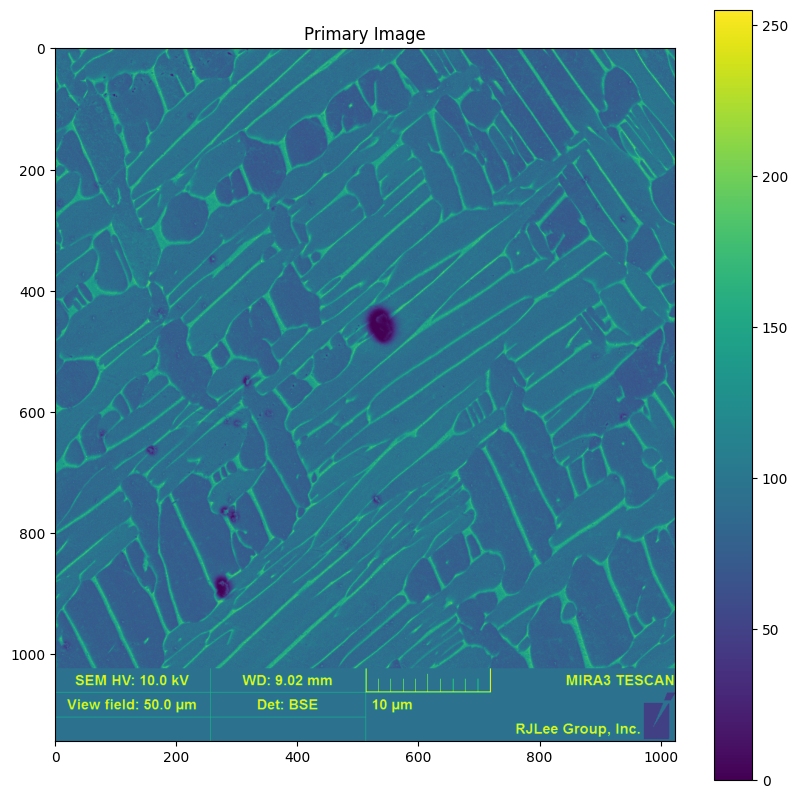

1403.6295807655238


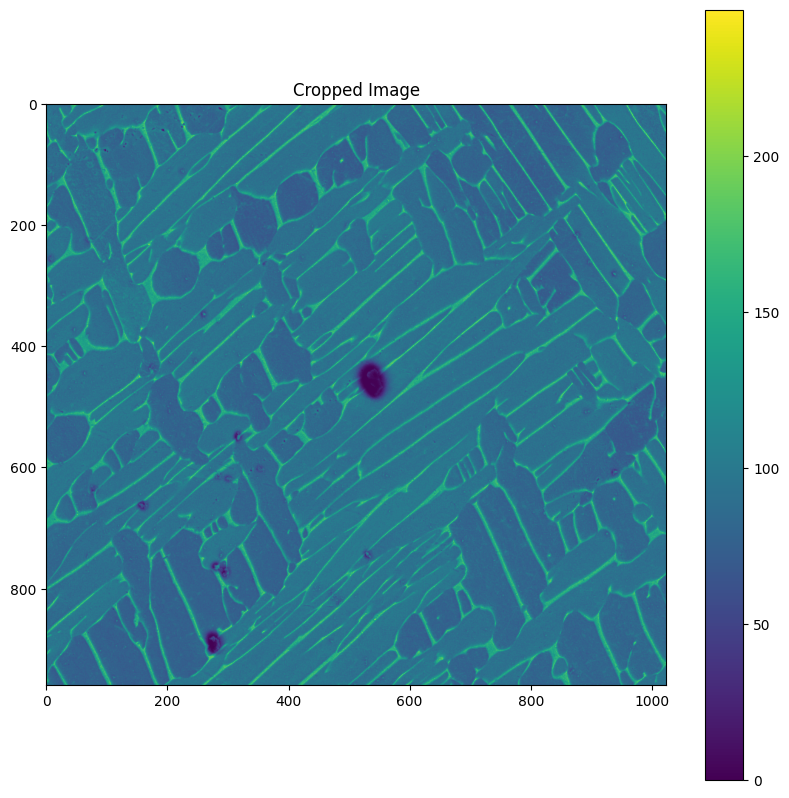

[[111 106 107 ...  97  92  94]
 [108 107 104 ...  89  92  96]
 [103 100 103 ...  82  89  86]
 ...
 [123 118 108 ...  97  86  94]
 [117  96  97 ...  95  93  92]
 [ 86  88  83 ...  89  96  90]]
247
0


C:\Users\ppak1\AppData\Local\Temp\ipykernel_26968\3606396172.py:33: FutureWarning: `multichannel` is a deprecated argument name for `estimate_sigma`. It will be removed in version 1.0. Please use `channel_axis` instead.
  sigma_est=np.mean(estimate_sigma(img1_inv, multichannel = True))
C:\Users\ppak1\AppData\Local\Temp\ipykernel_26968\3606396172.py:34: FutureWarning: `multichannel` is a deprecated argument name for `denoise_nl_means`. It will be removed in version 1.0. Please use `channel_axis` instead.
  nlm=denoise_nl_means(img1_inv,h=1.15*sigma_est,fast_mode=True,patch_size=5,patch_distance=3,multichannel=False,preserve_range=True).astype('uint8')


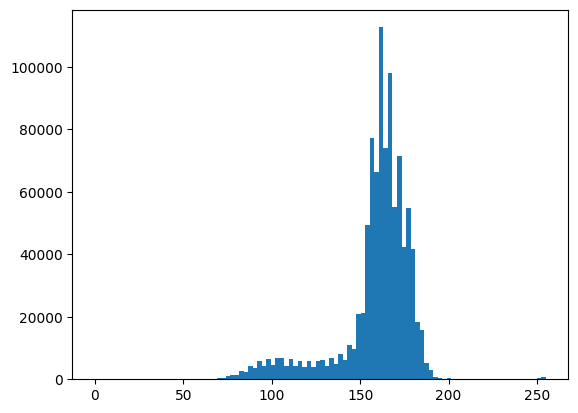

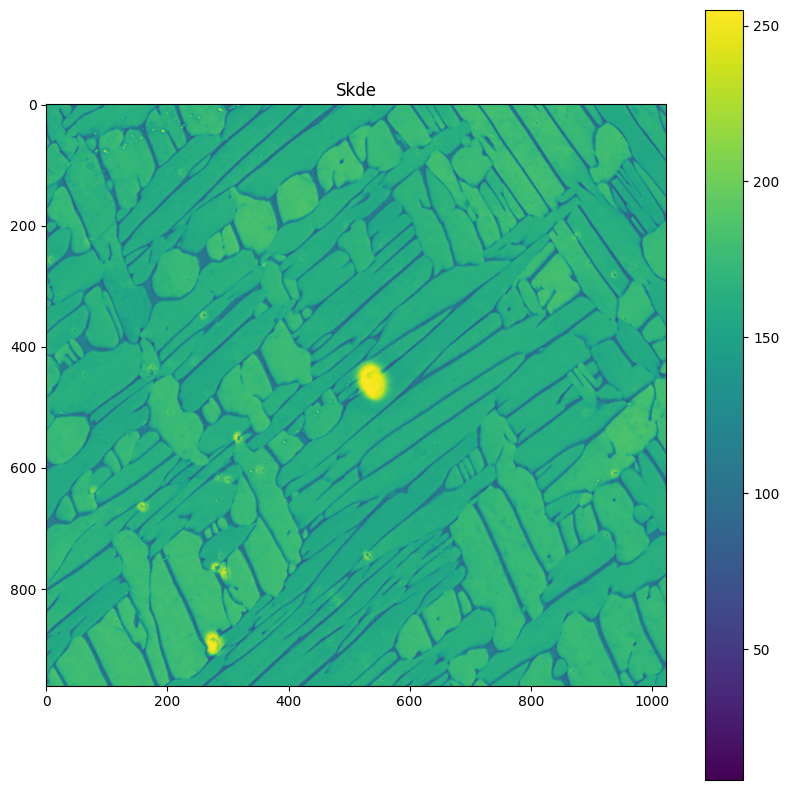

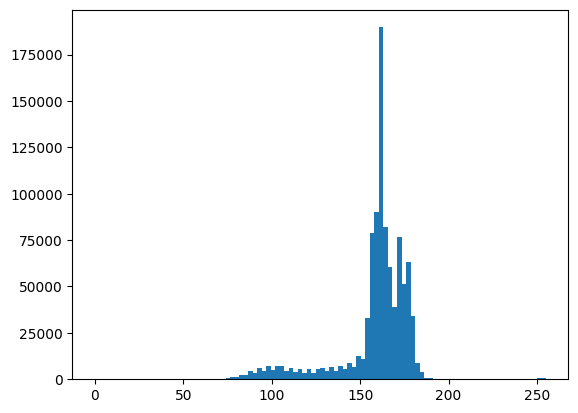

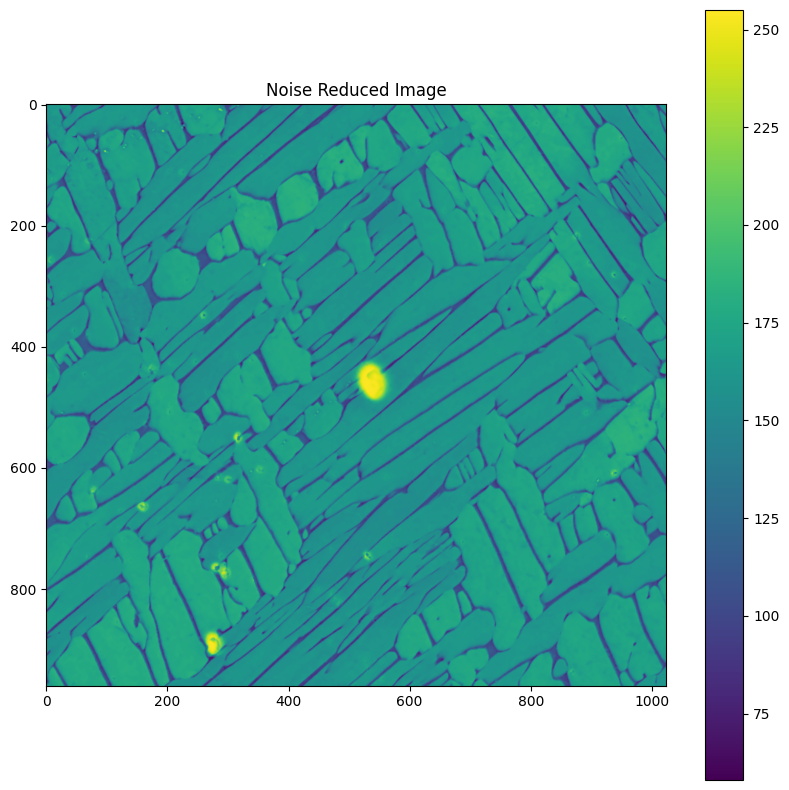

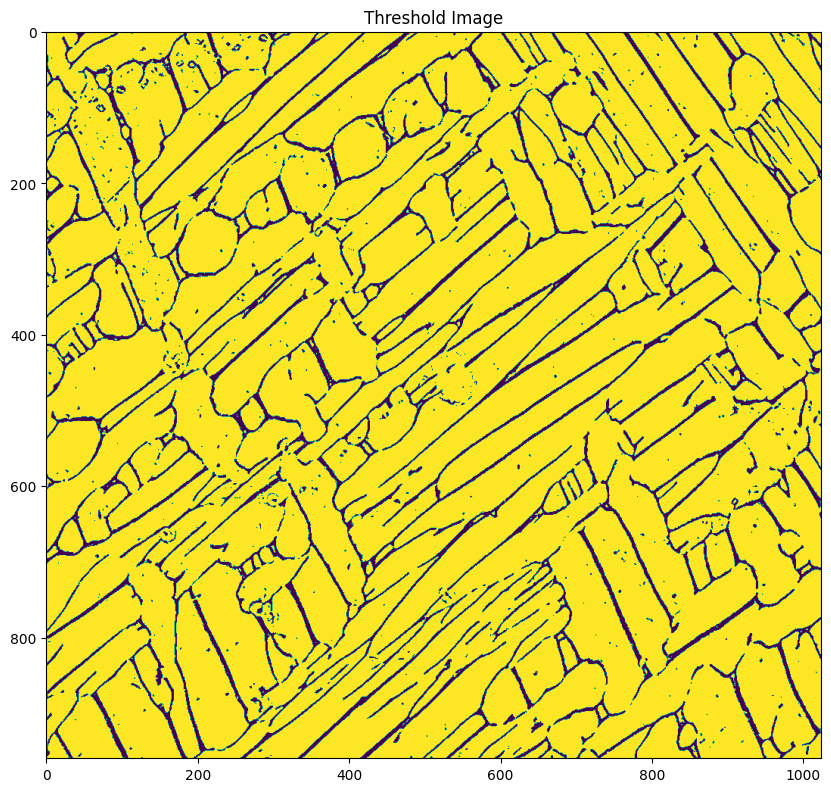

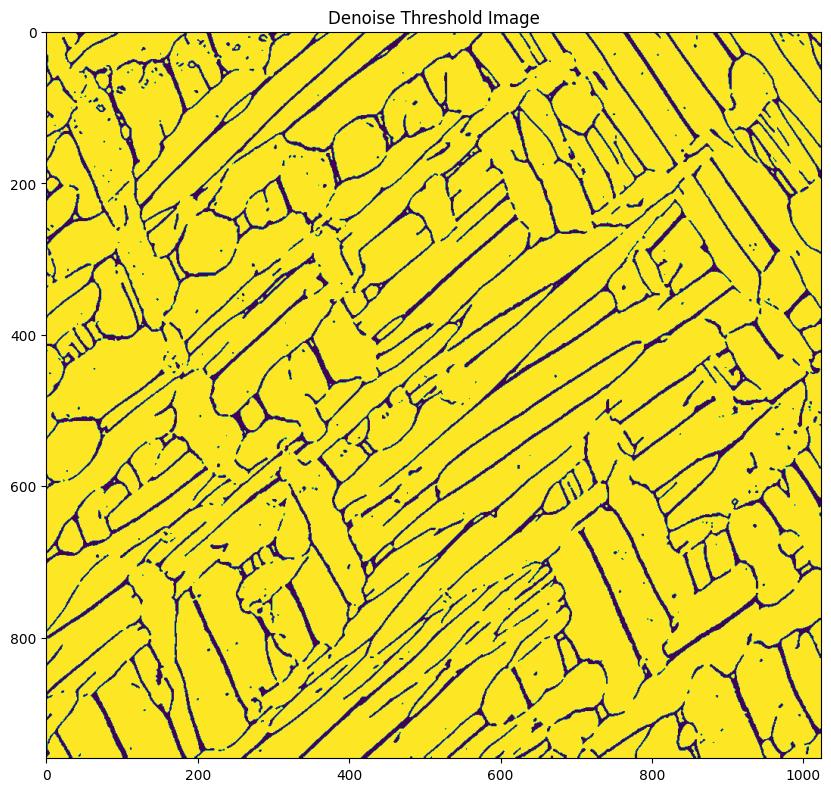

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [0 0 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
(960, 1024)
(960, 1024)
[480 512]
983040
1024


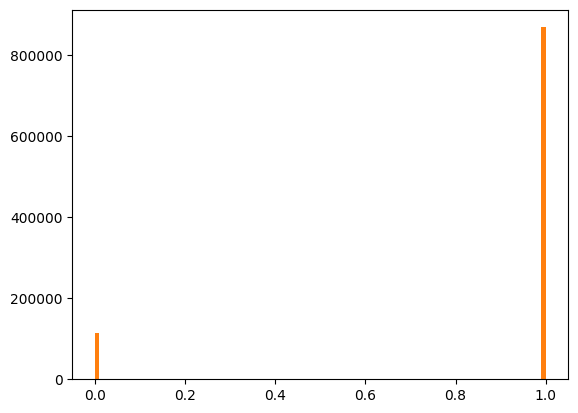

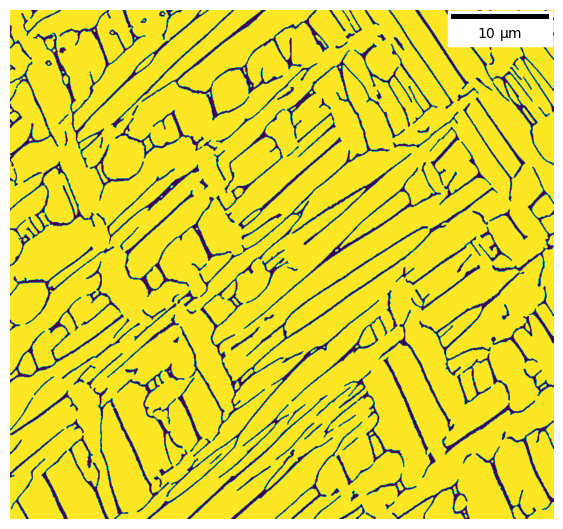

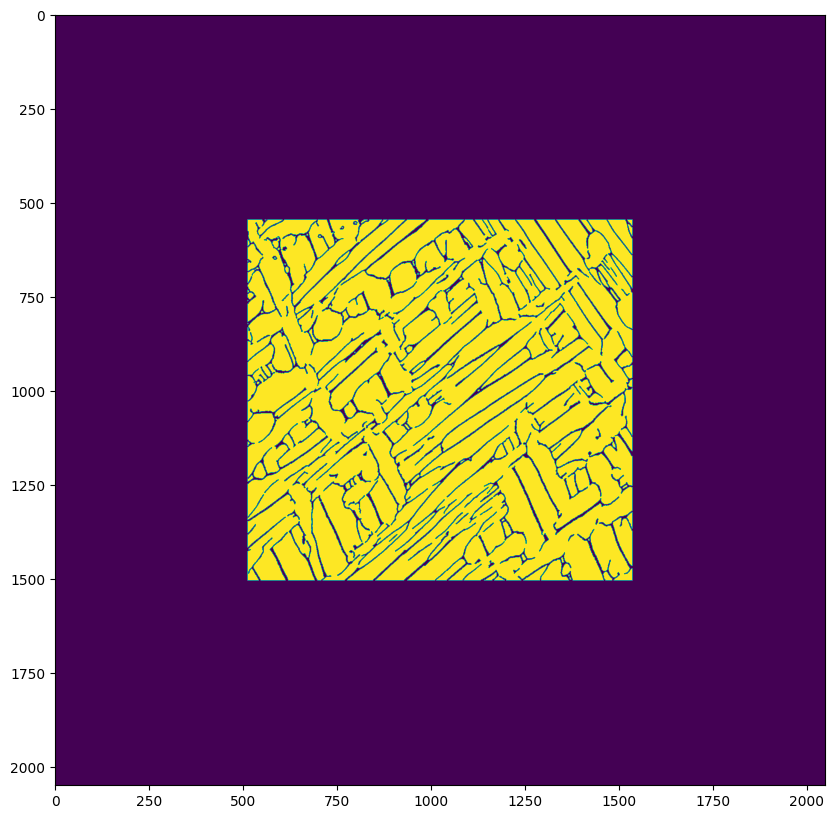

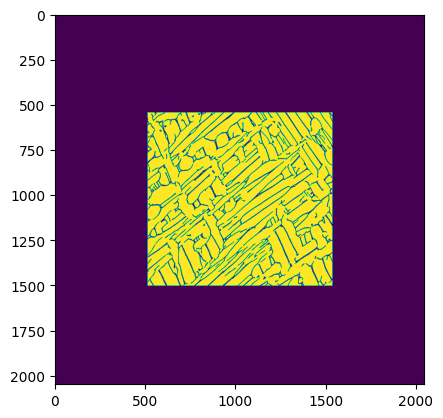

[39  4 40 ... 83 18 50]
22433
The sum of Alpha is : 873458
The Alpha Fraction is : 88.85274251302083
38.93977085283759
0.04882057126983561
Average distance list: [38.93977085283759]
Average distance in pixels for all rotations: 38.93977085283759
Average Inv distance in pixels for all rotations: 0.04882057126983561
Average Area Frac: [88.85274251302083]
The Thickness in um is : 0.7339237809502214
The file name is: image 1.tif
2022-12-01 09:38:20.441693


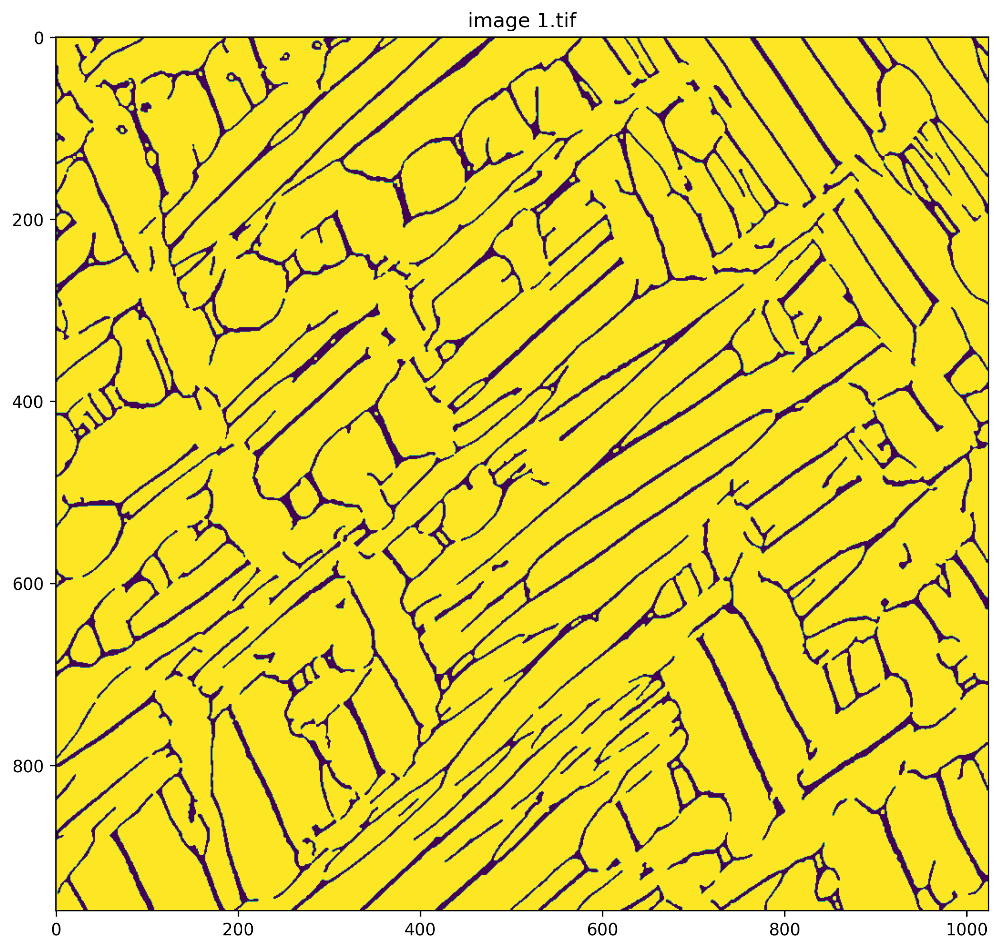

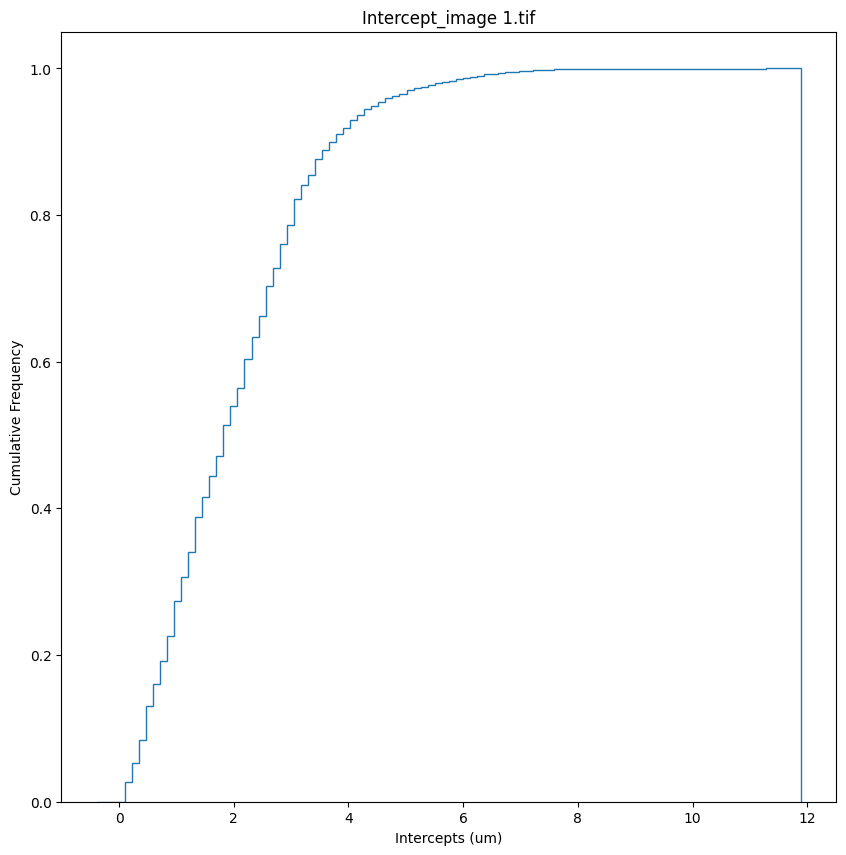

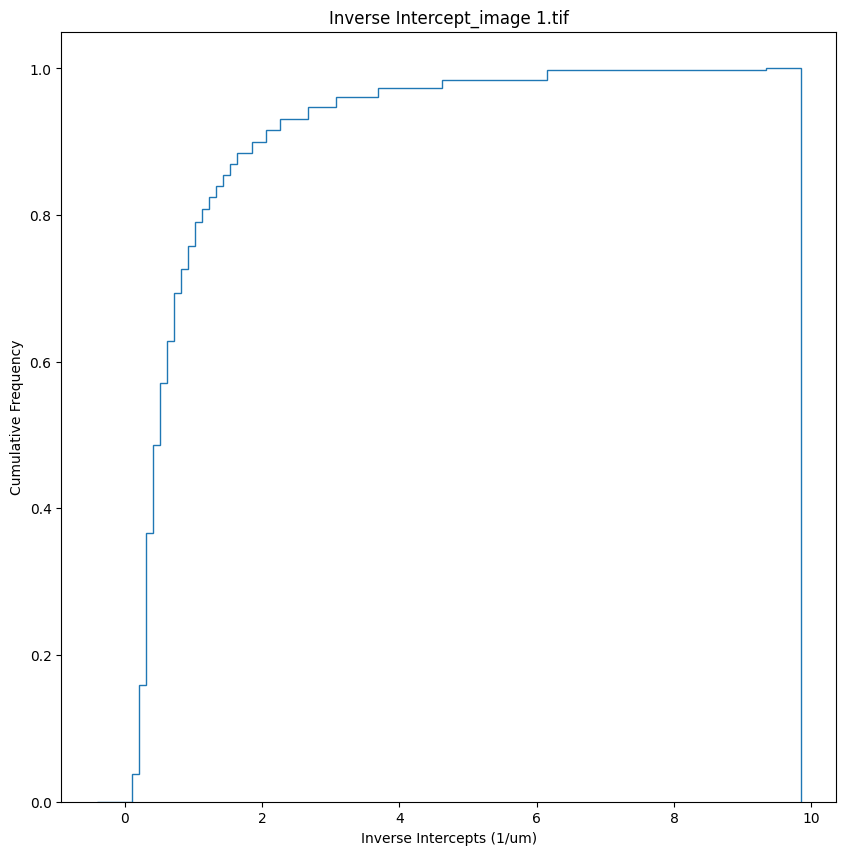

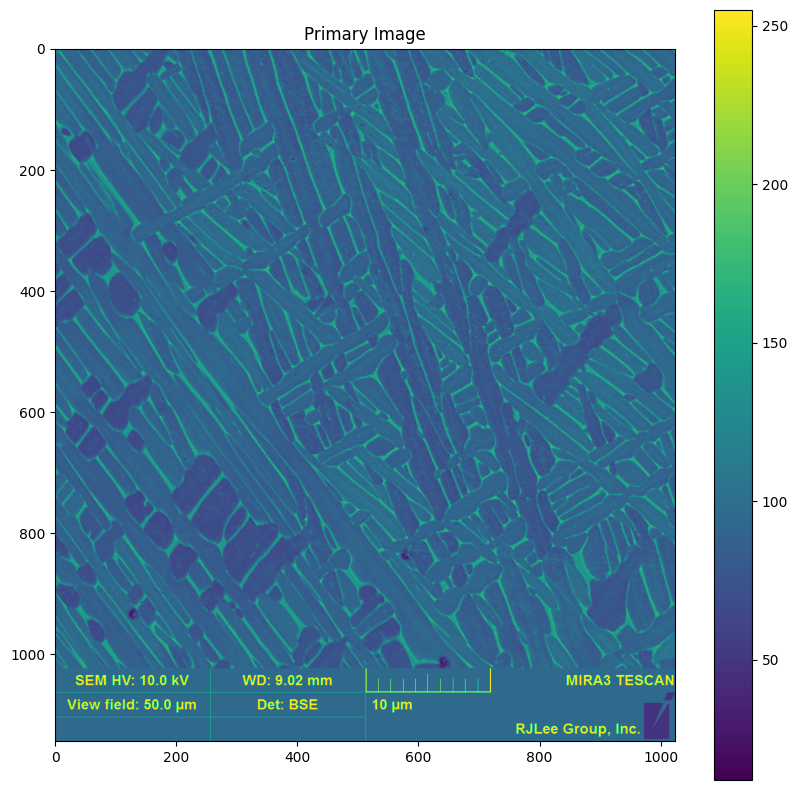

1403.6295807655238


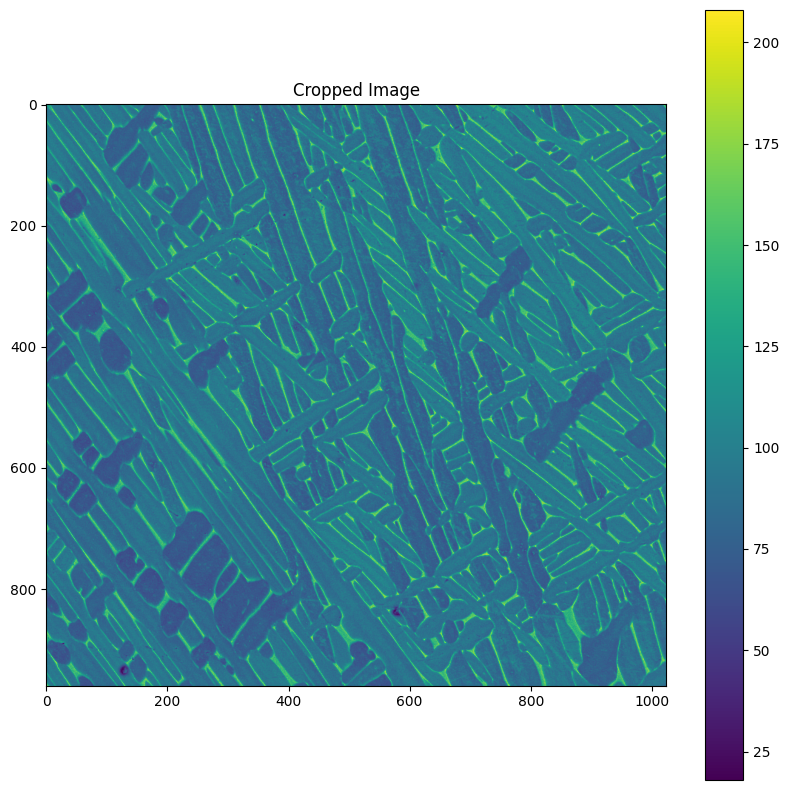

[[118 121 114 ...  90  85  84]
 [114 125 128 ...  98  87  88]
 [105 126 142 ... 122  92  84]
 ...
 [159 176 143 ...  86  88  81]
 [162 156 172 ...  87  88  99]
 [148 160 157 ...  84  85  90]]
208
18


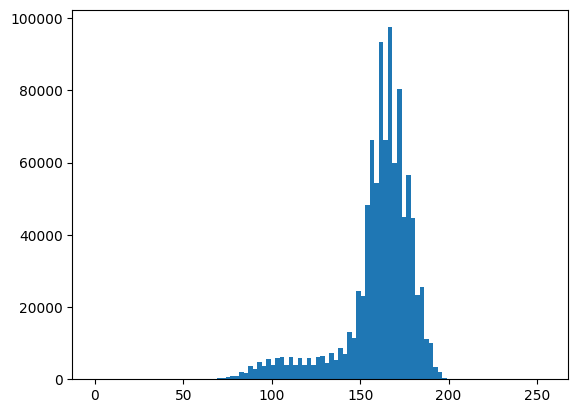

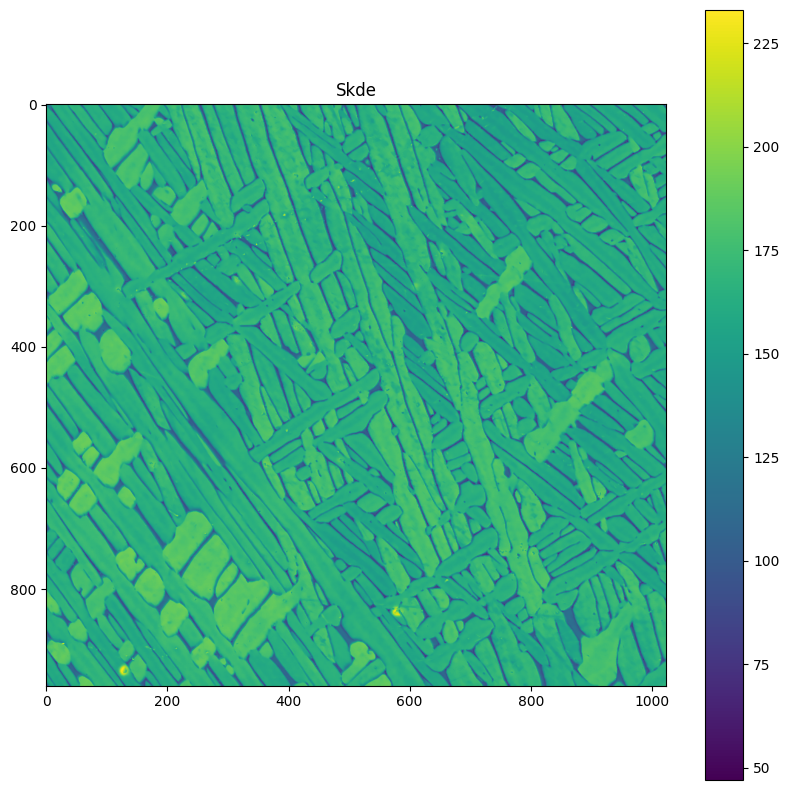

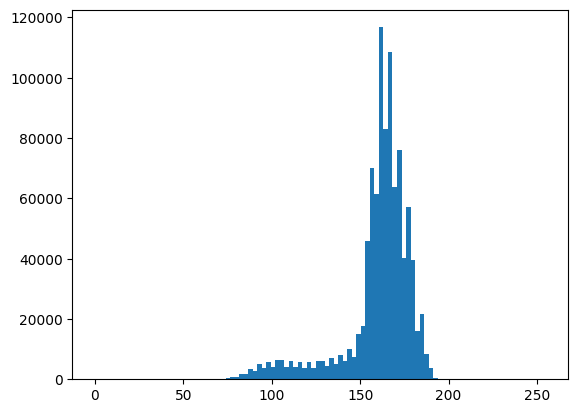

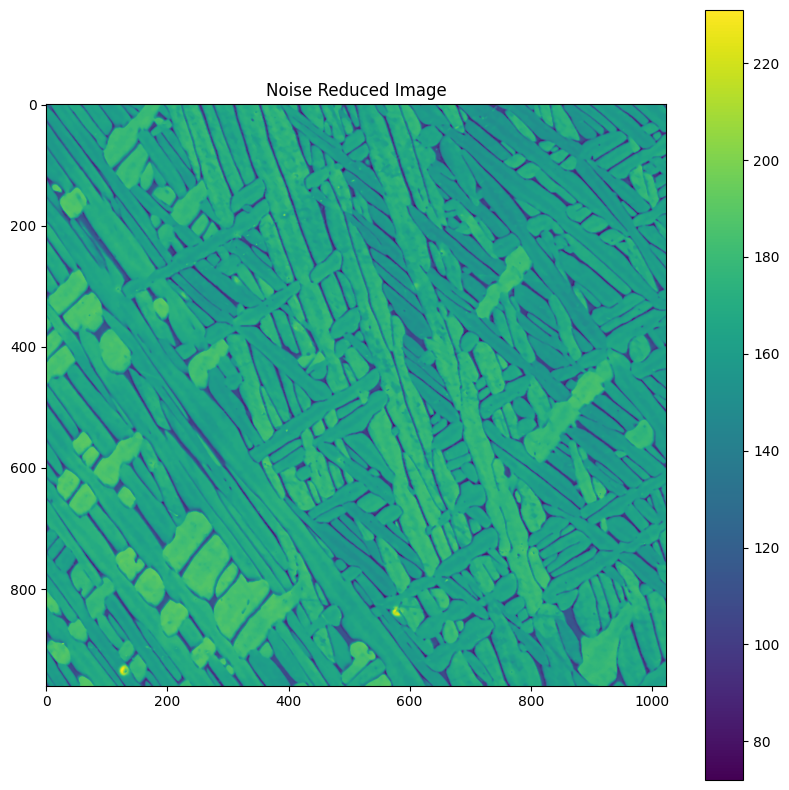

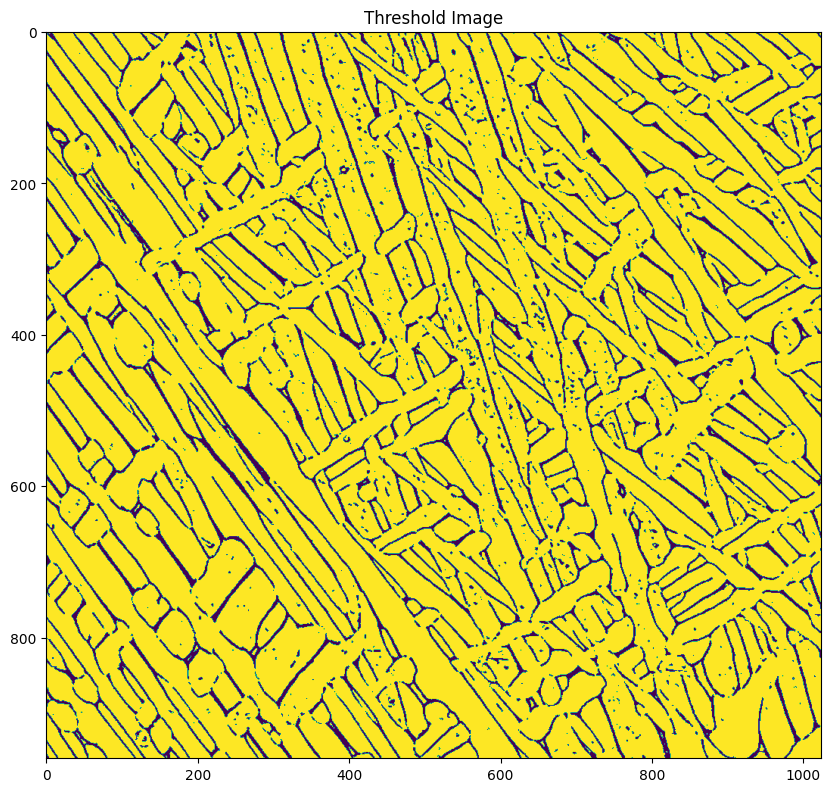

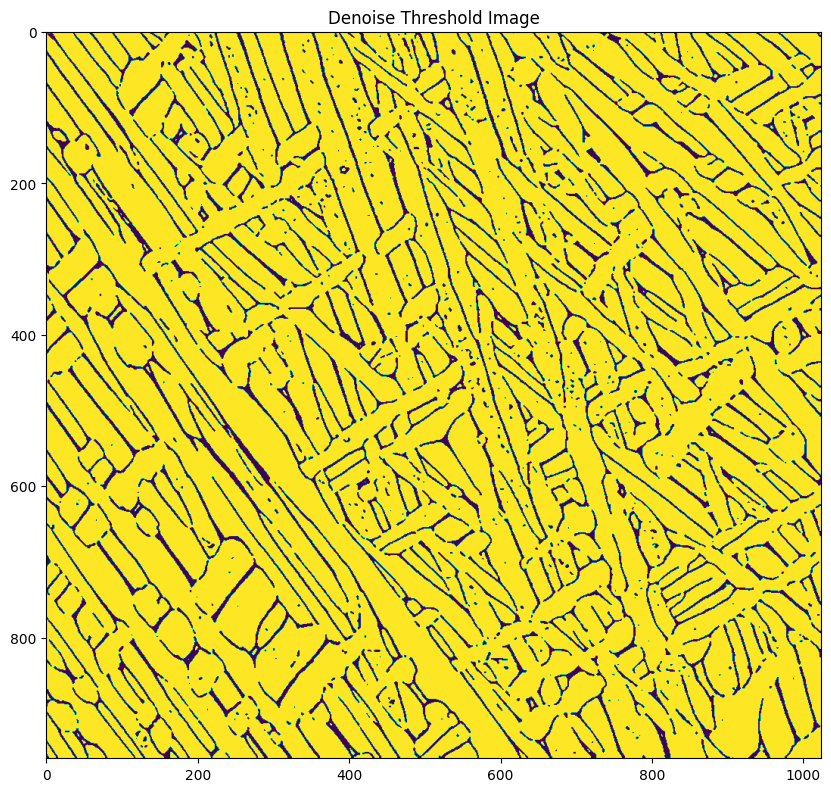

[[0 1 1 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [1 0 0 ... 0 1 1]
 ...
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [1 0 0 ... 1 1 1]]
(960, 1024)
(960, 1024)
[480 512]
983040
1024


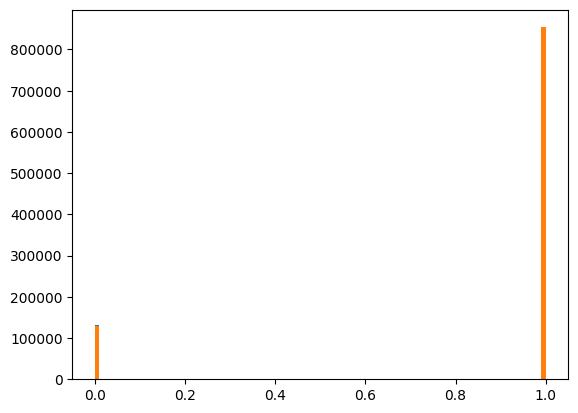

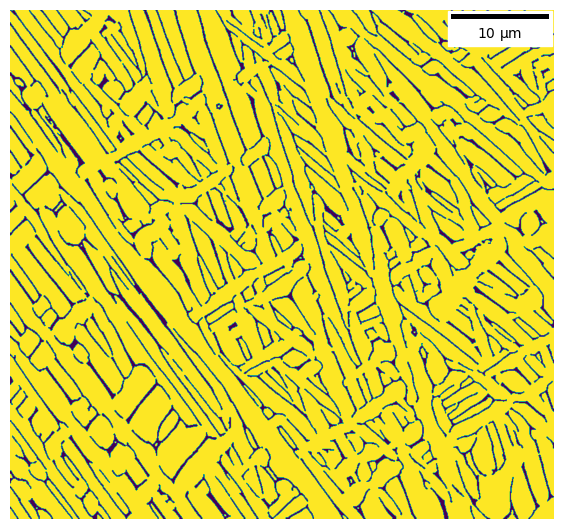

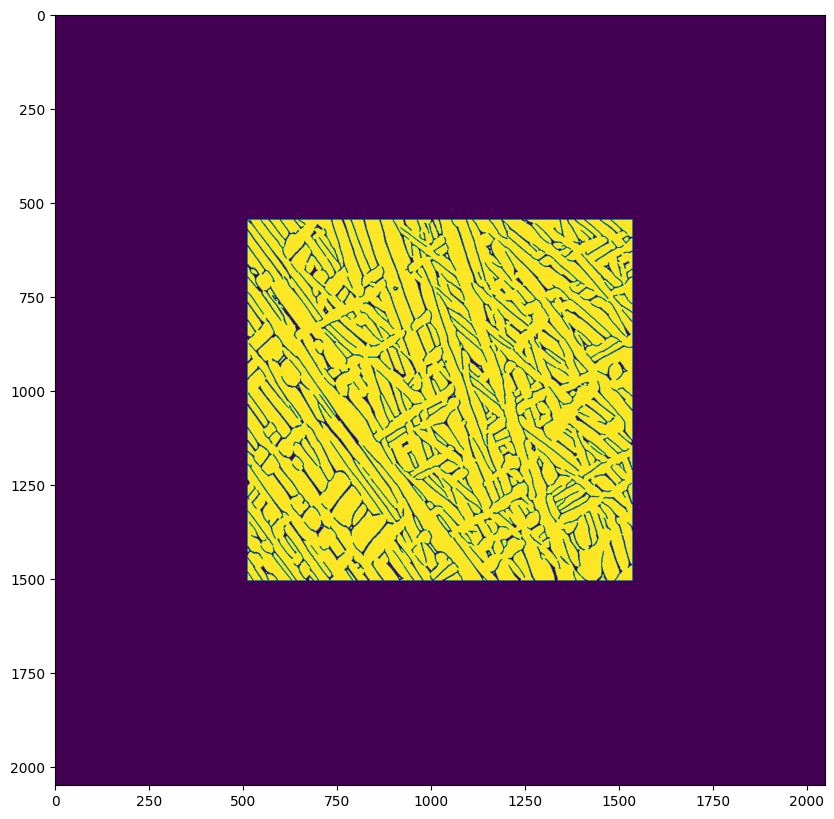

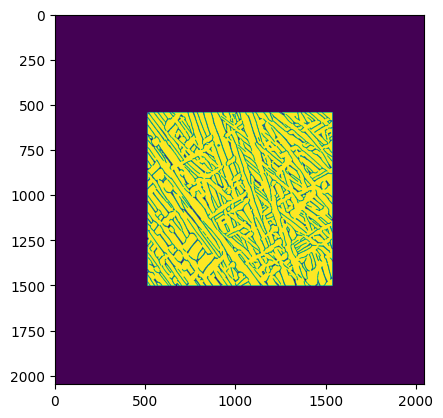

[ 4 27 19 ... 17 19 45]
30302
The sum of Alpha is : 863198
The Alpha Fraction is : 87.80904134114583
28.48838283828383
0.05391879582946163
Average distance list: [28.48838283828383]
Average distance in pixels for all rotations: 28.48838283828383
Average Inv distance in pixels for all rotations: 0.05391879582946163
Average Area Frac: [87.80904134114583]
The Thickness in um is : 0.6644301305755402
The file name is: image 15.tif
2022-12-01 09:39:23.897213


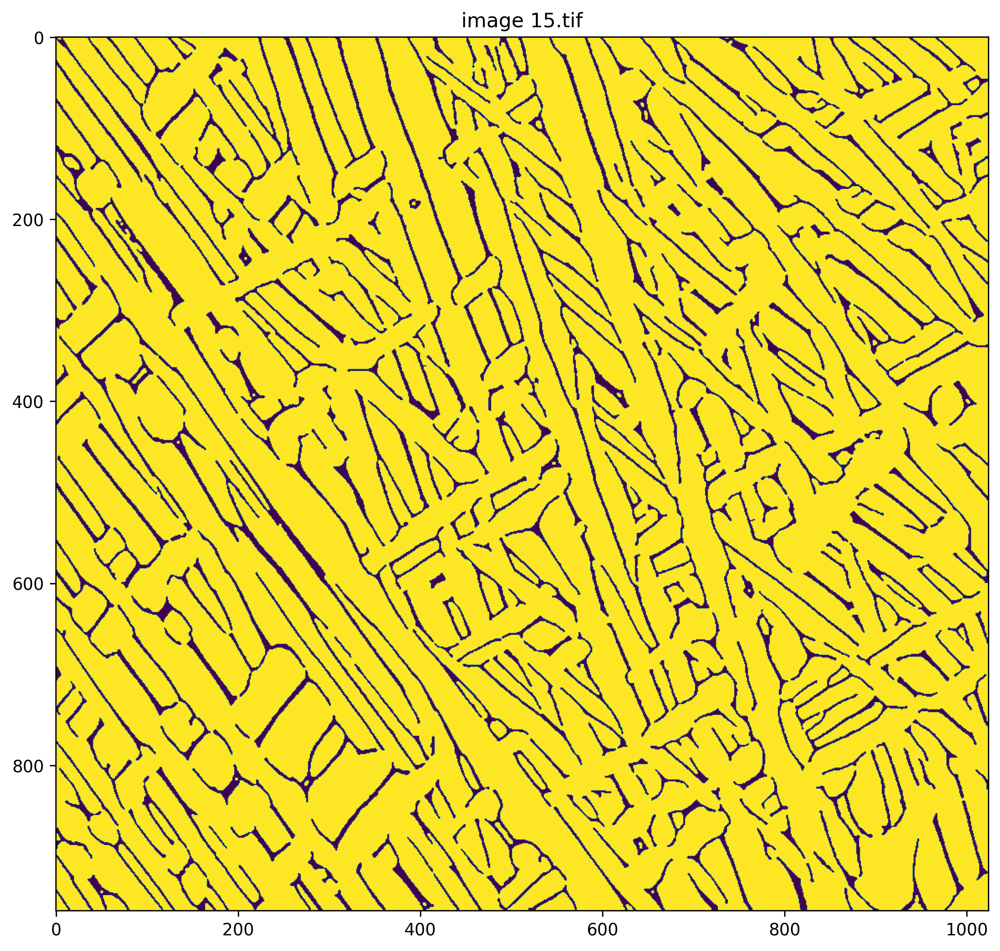

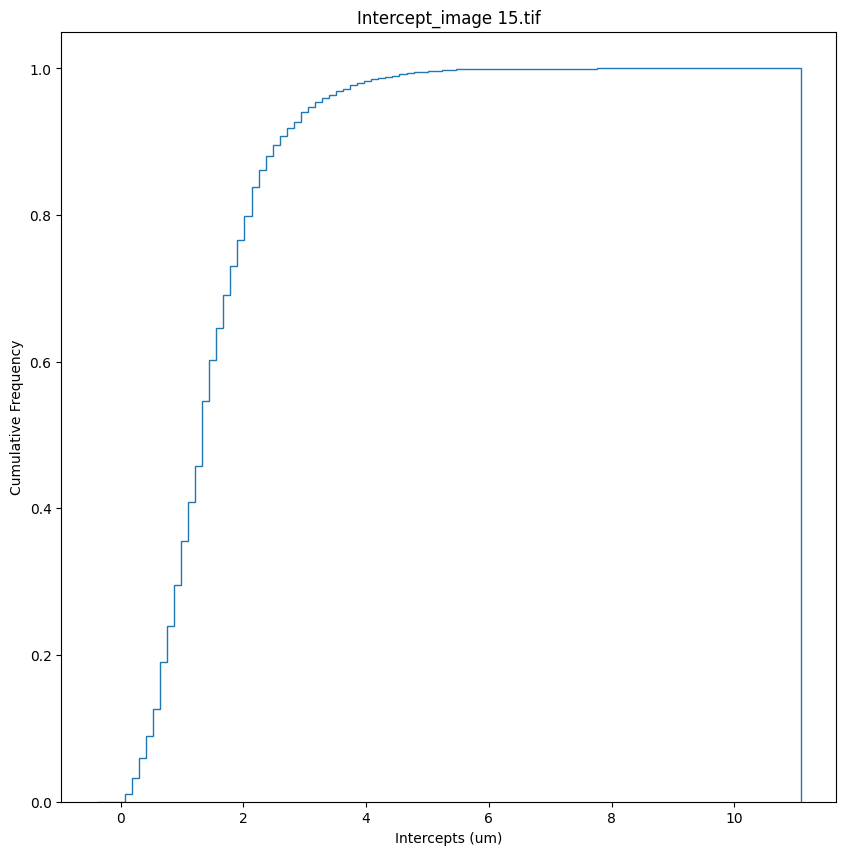

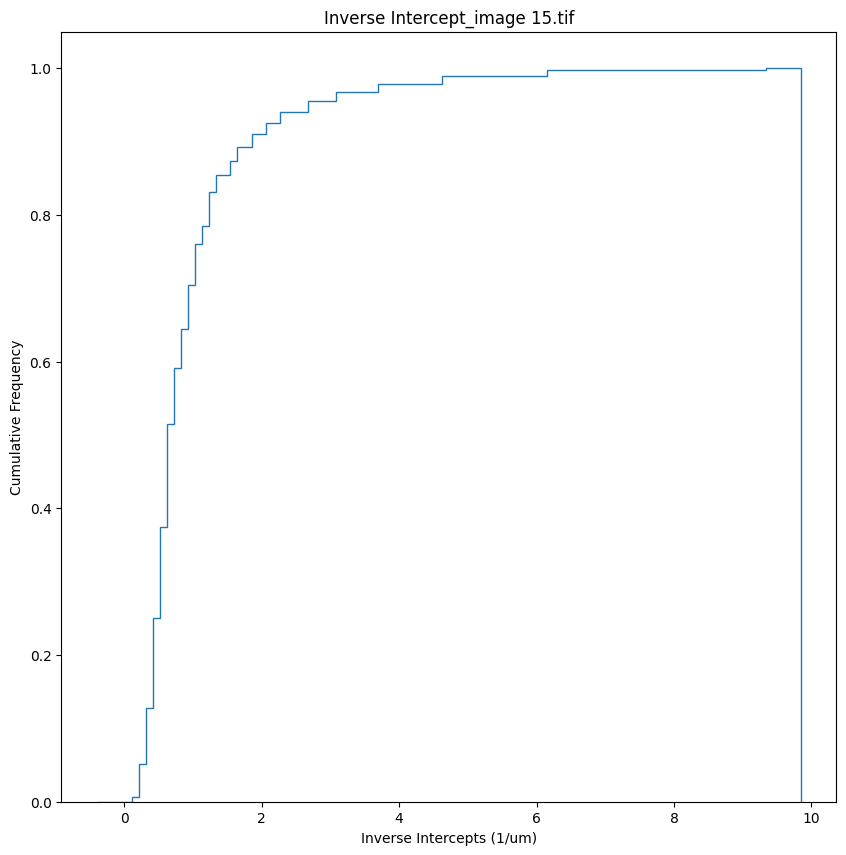

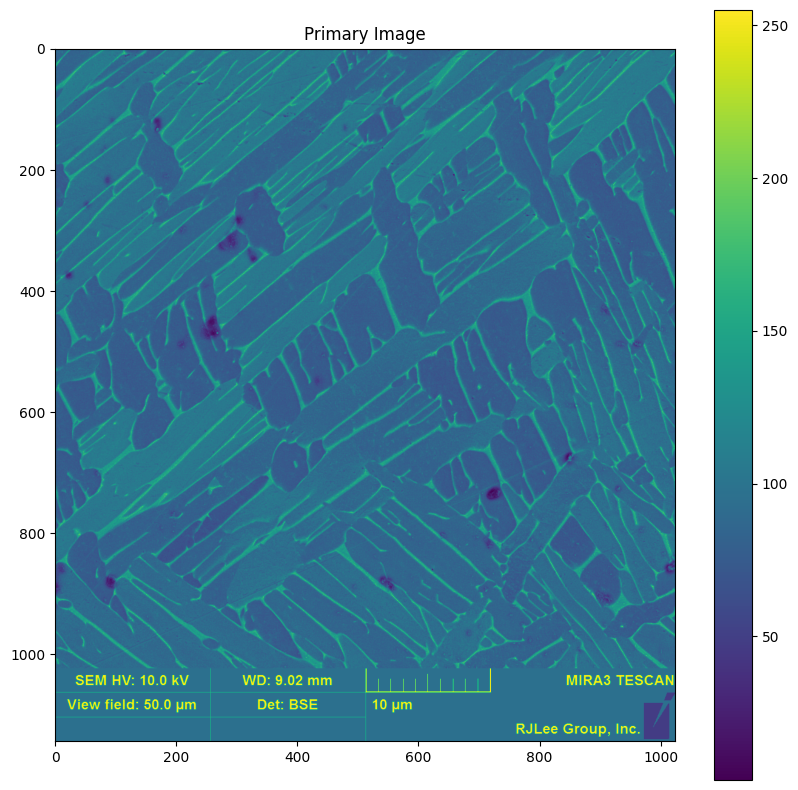

1403.6295807655238


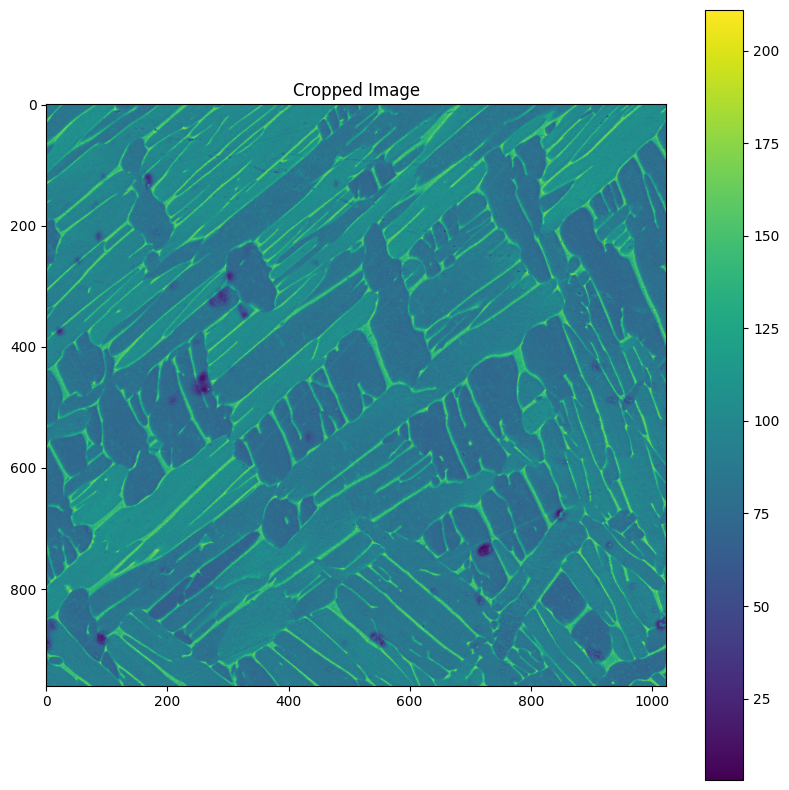

[[ 83  87  90 ... 111  91  99]
 [ 87  90  83 ...  95  98  99]
 [ 90  92  82 ... 105 113  96]
 ...
 [ 83  95  88 ...  88  85  89]
 [ 98  89  95 ...  81  87  81]
 [ 98  92  86 ...  86  89  88]]
211
3


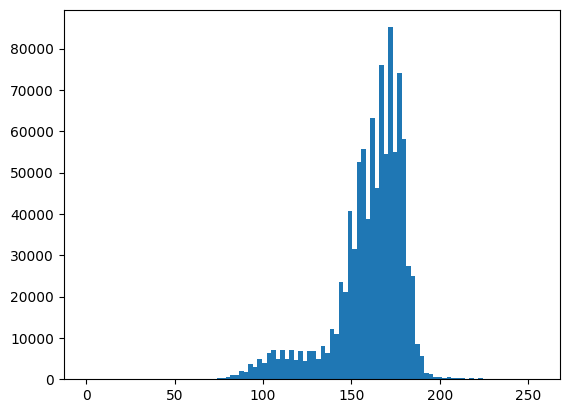

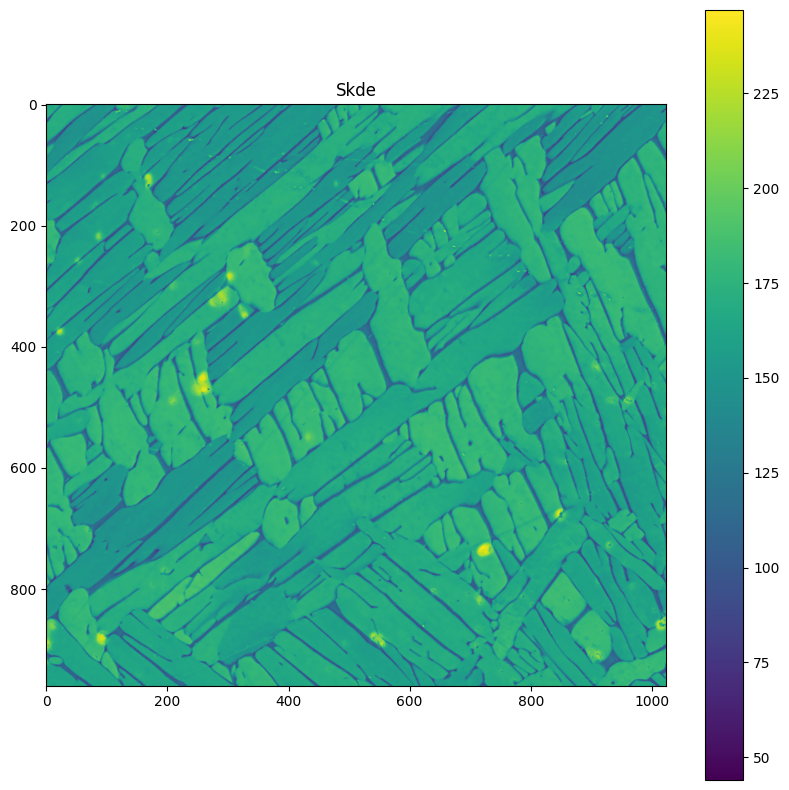

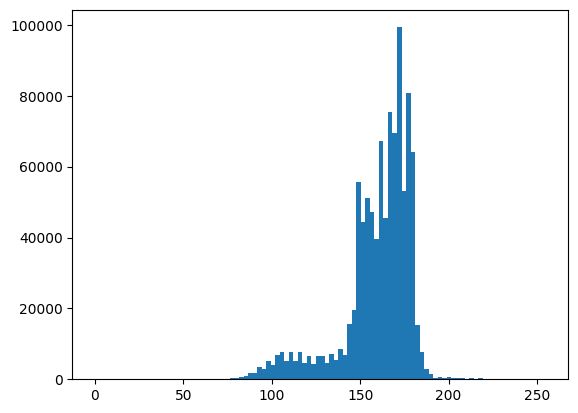

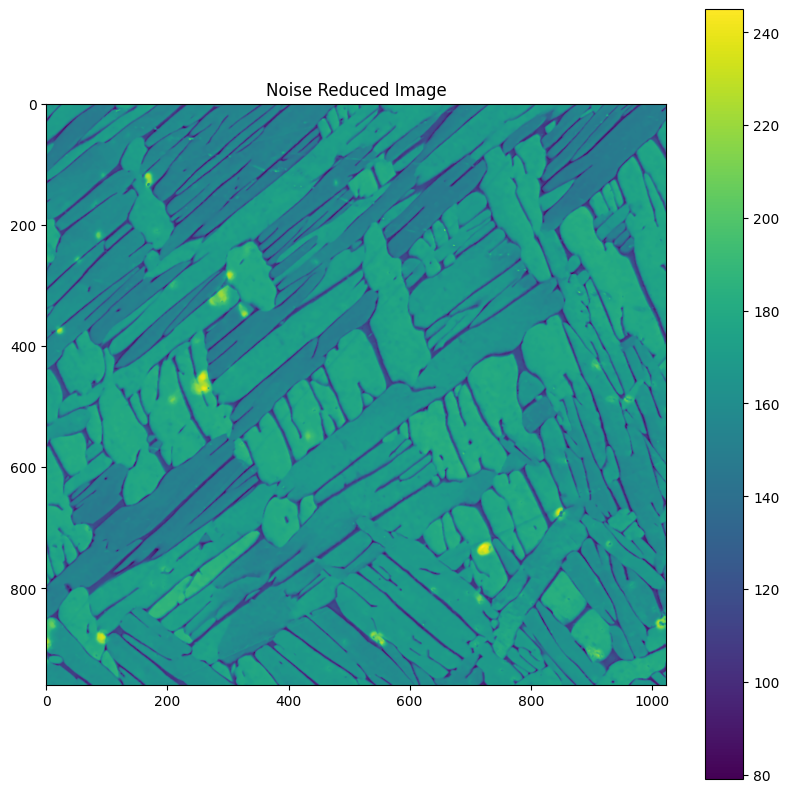

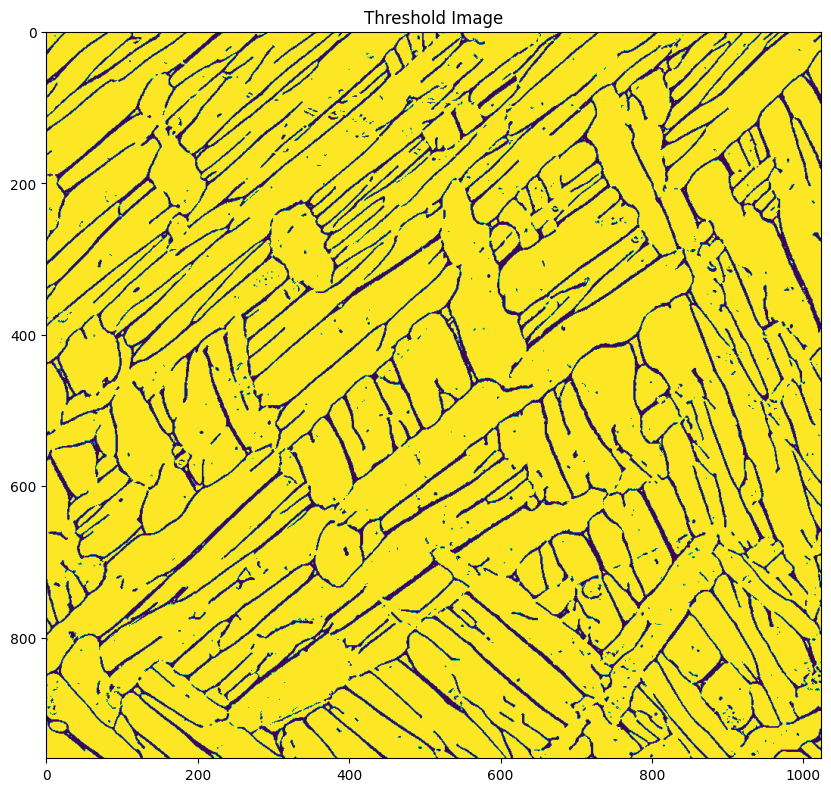

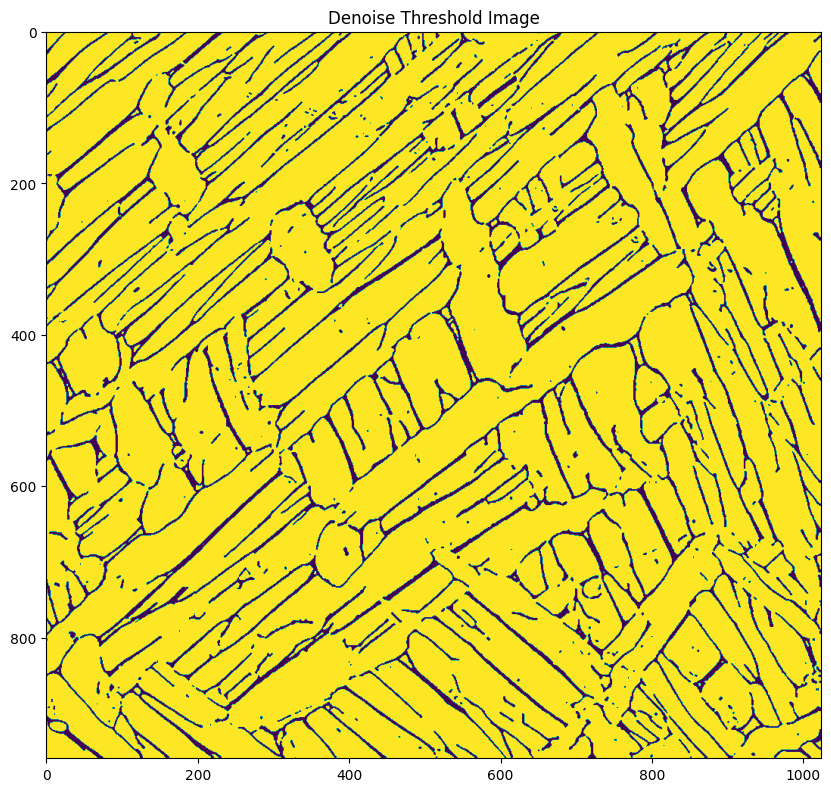

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
(960, 1024)
(960, 1024)
[480 512]
983040
1024


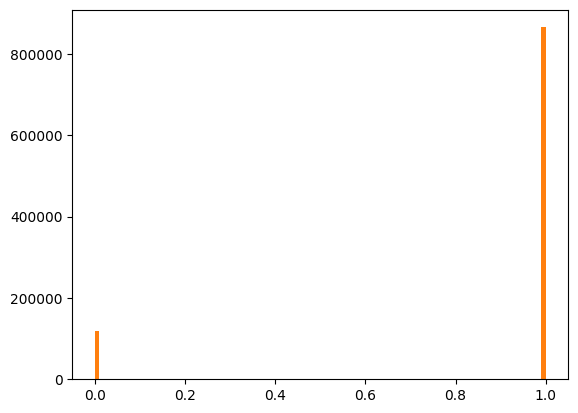

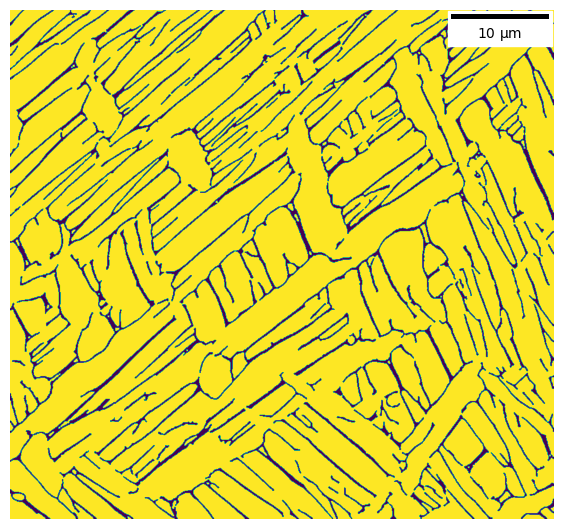

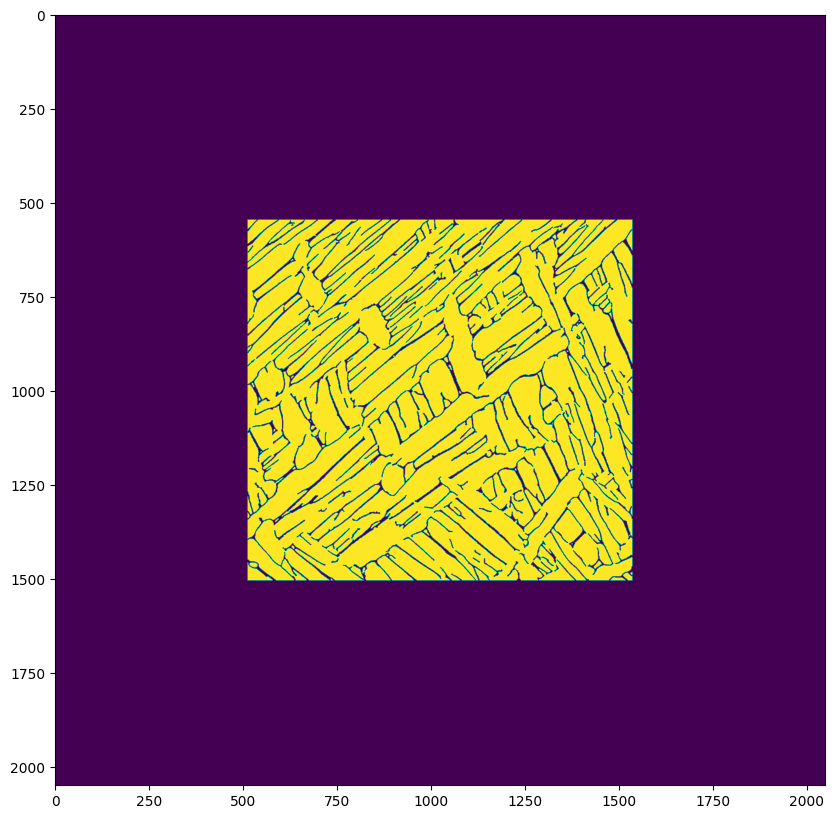

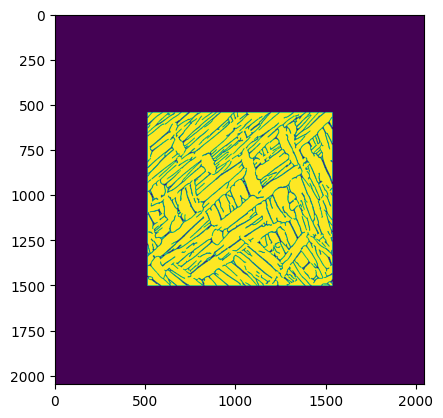

[24 52 66 ... 54 41 13]
24587
The sum of Alpha is : 870112
The Alpha Fraction is : 88.51236979166667
35.39198698393329
0.052264047524368765
Average distance list: [35.39198698393329]
Average distance in pixels for all rotations: 35.39198698393329
Average Inv distance in pixels for all rotations: 0.052264047524368765
Average Area Frac: [88.51236979166667]
The Thickness in um is : 0.6855283247135243
The file name is: image 24.tif
2022-12-01 09:40:41.268373


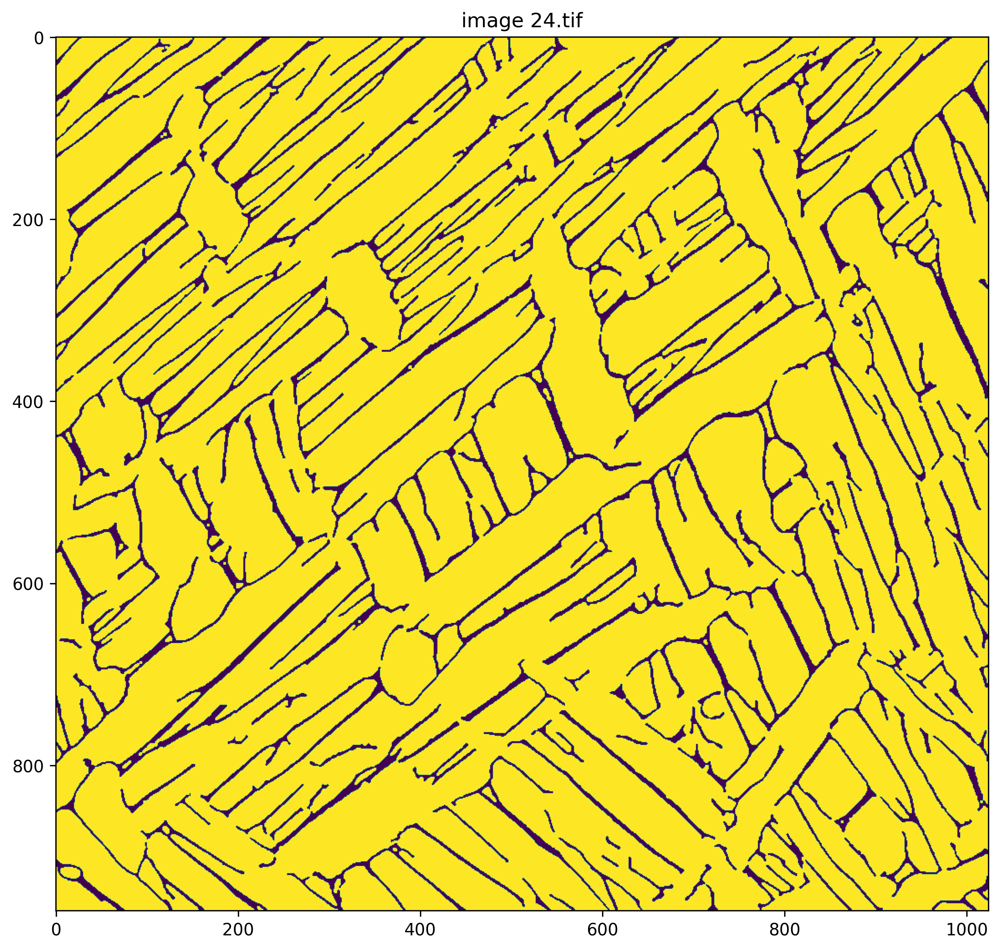

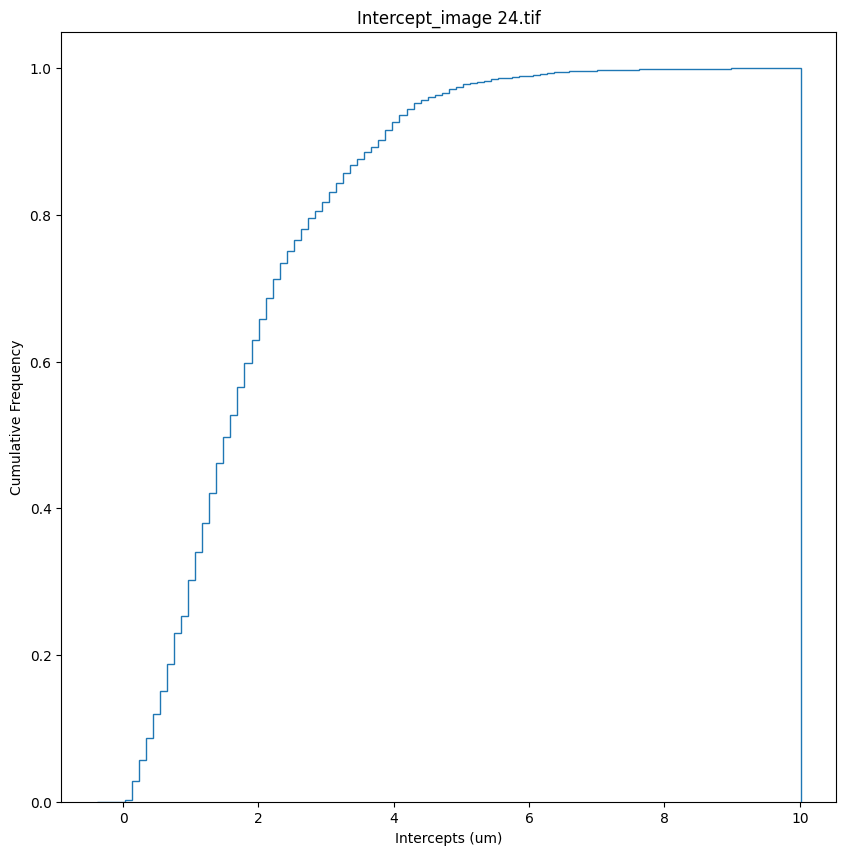

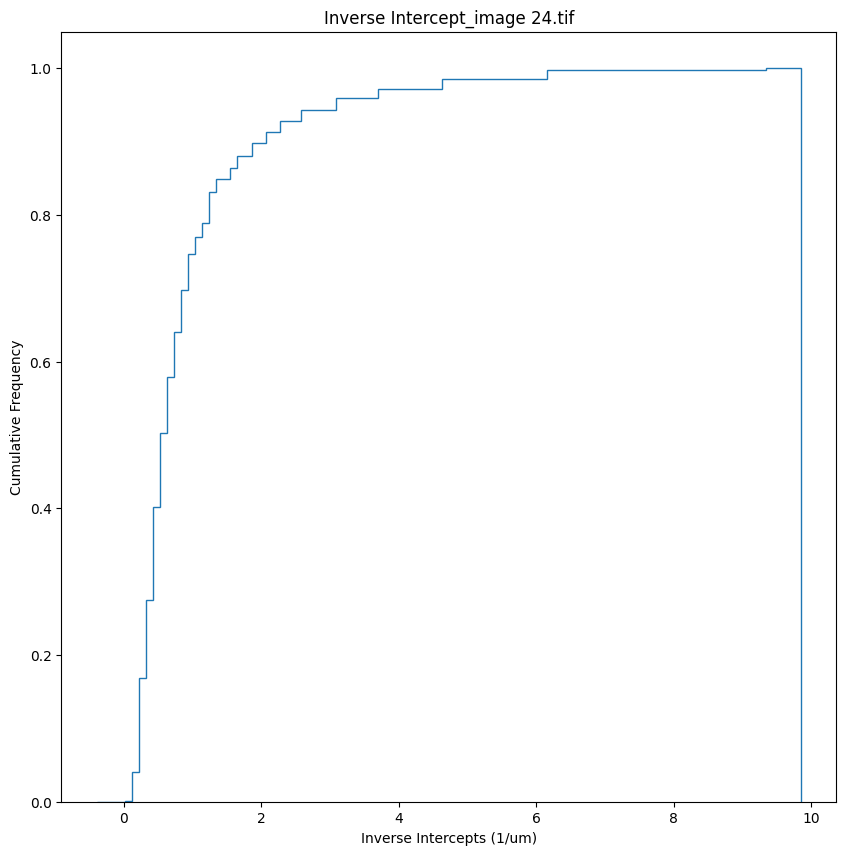

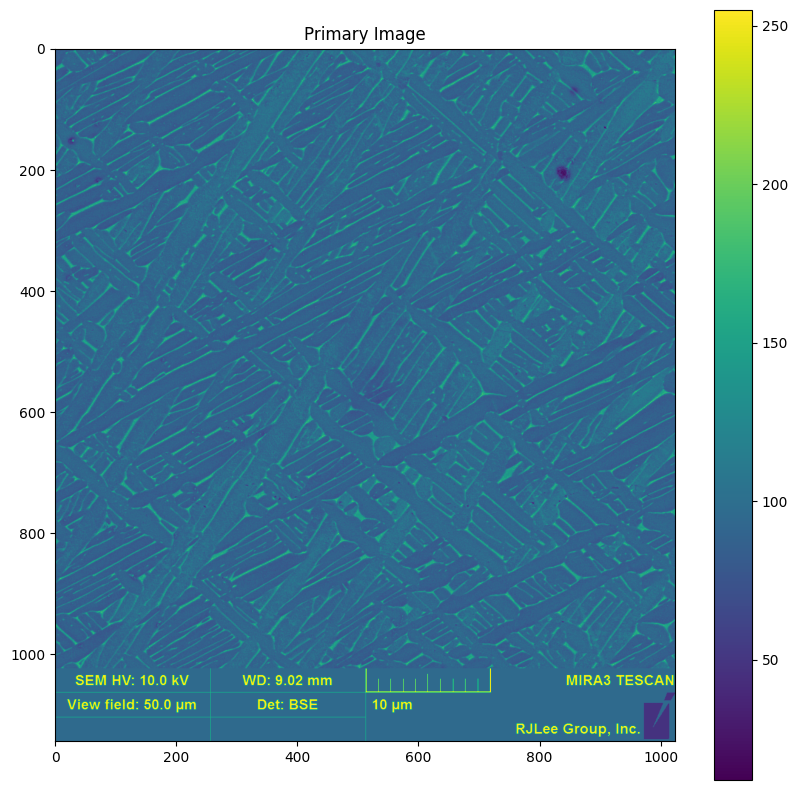

1403.6295807655238


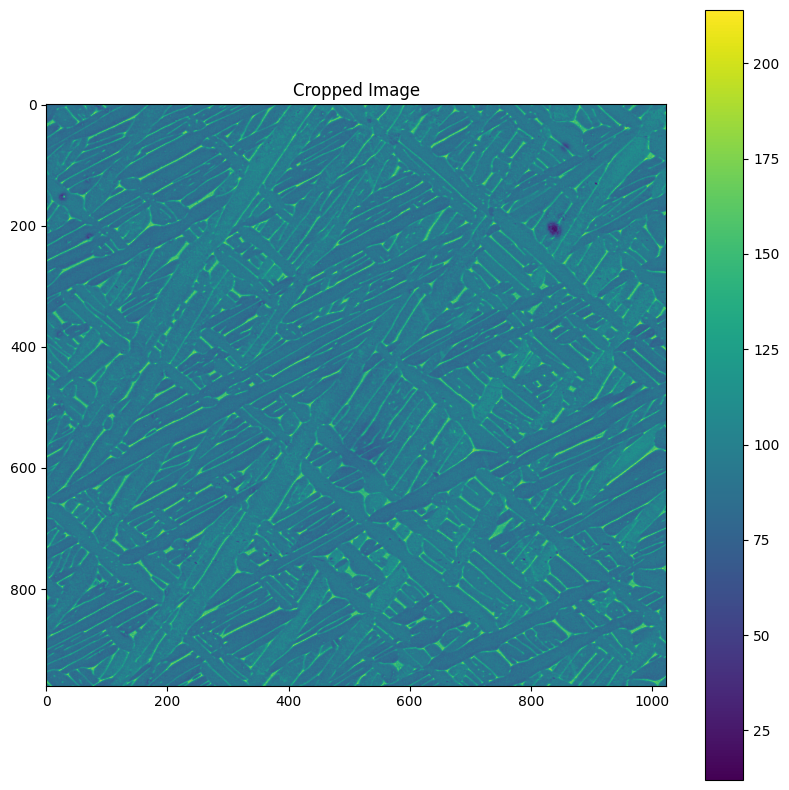

[[ 88  88  84 ...  92  94 106]
 [ 84  79  88 ...  87 100 131]
 [ 83  81  85 ... 141 150 100]
 ...
 [ 83  86 102 ...  81  88  85]
 [ 78  86  90 ...  79  89  93]
 [ 91  82  93 ...  87  91  97]]
214
12


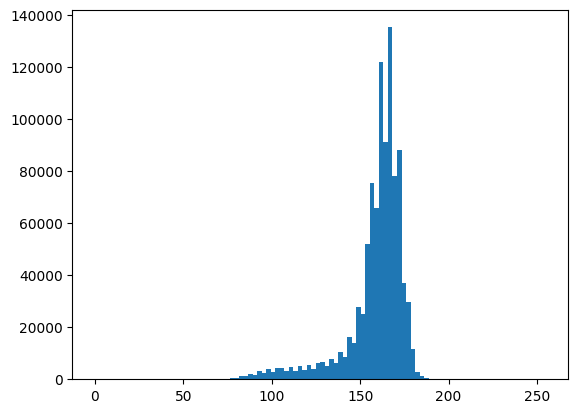

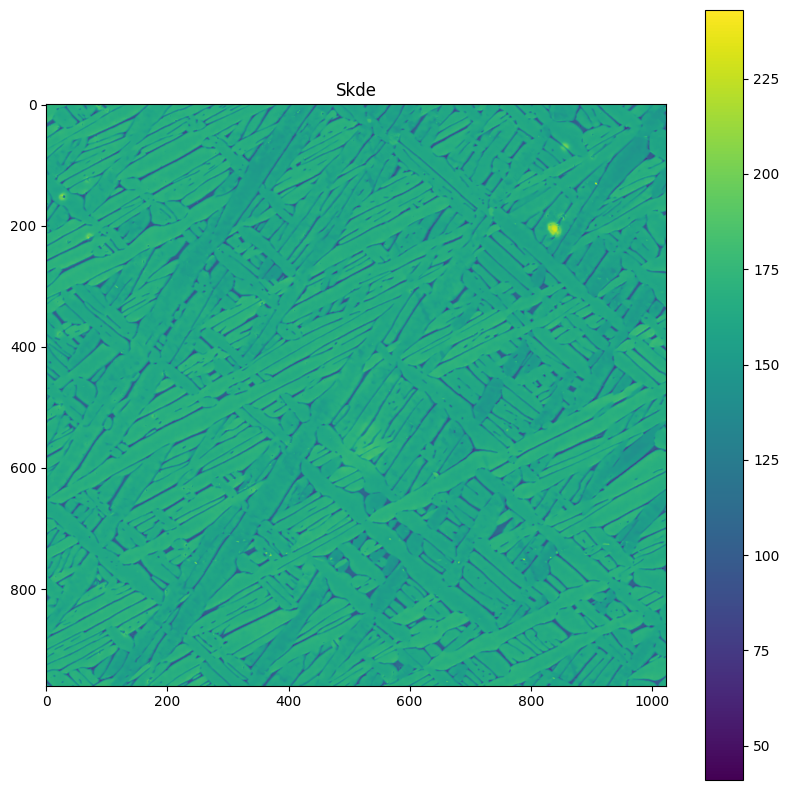

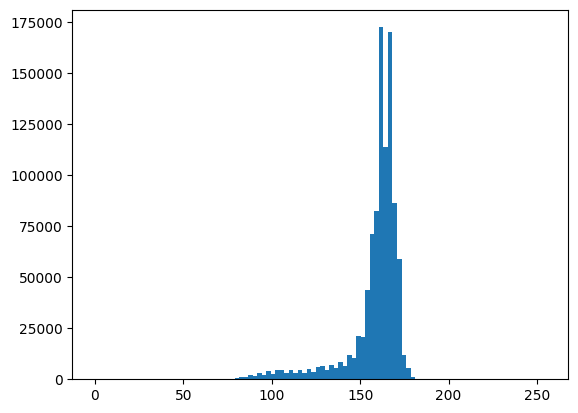

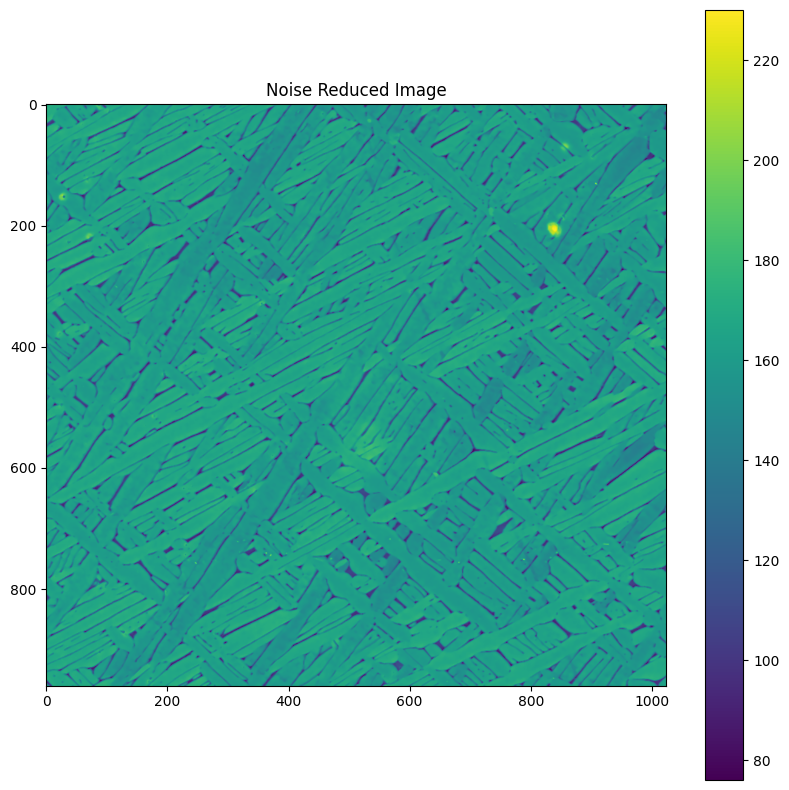

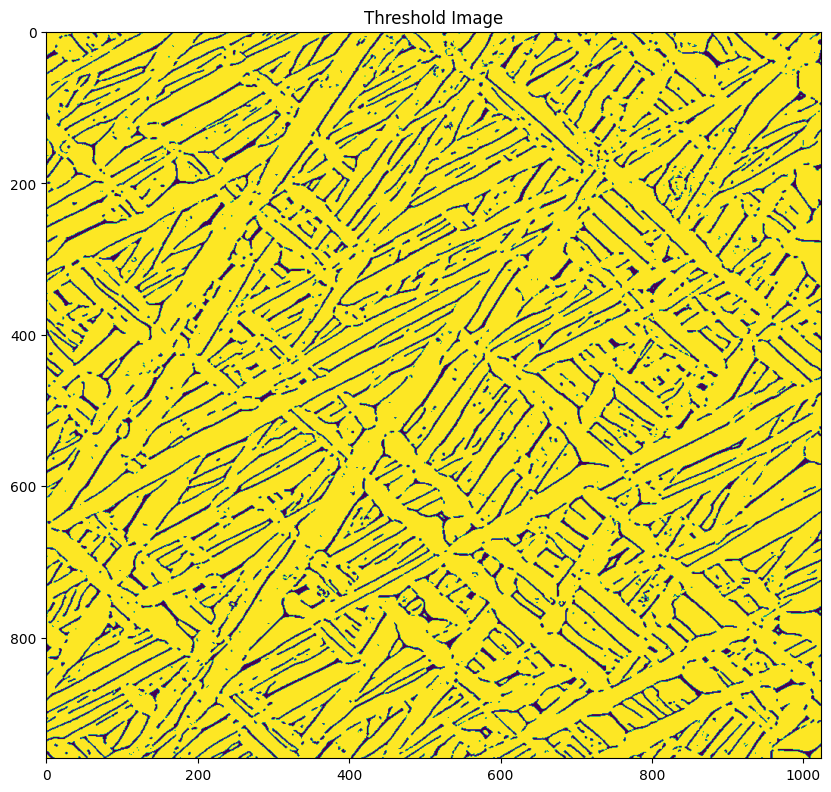

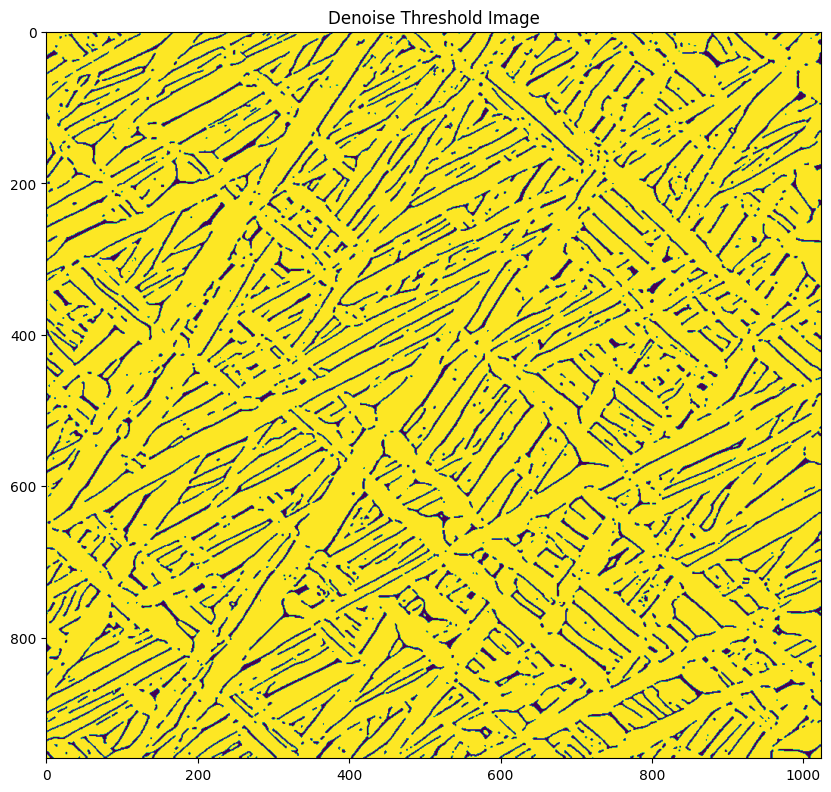

[[1 1 1 ... 1 1 0]
 [1 1 1 ... 1 1 0]
 [1 1 1 ... 0 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
(960, 1024)
(960, 1024)
[480 512]
983040
1024


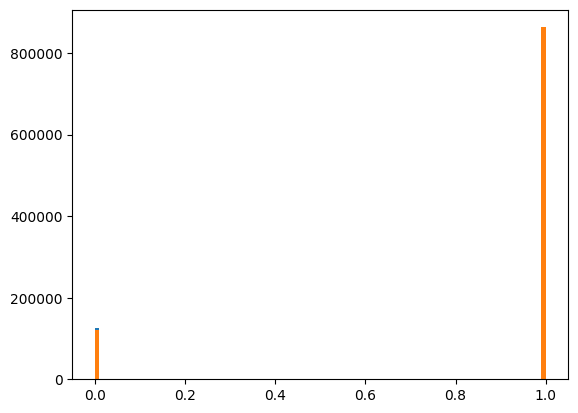

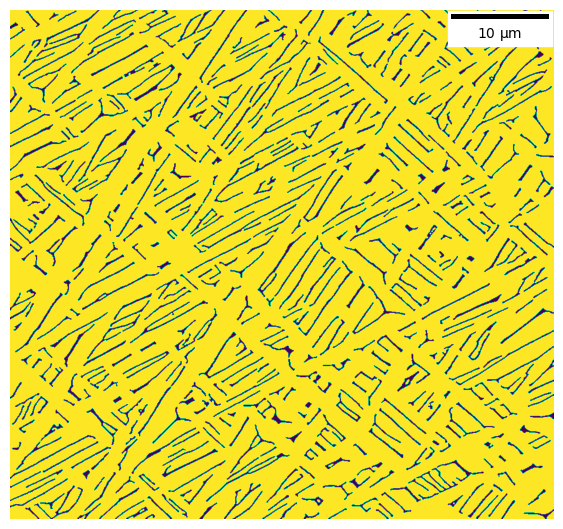

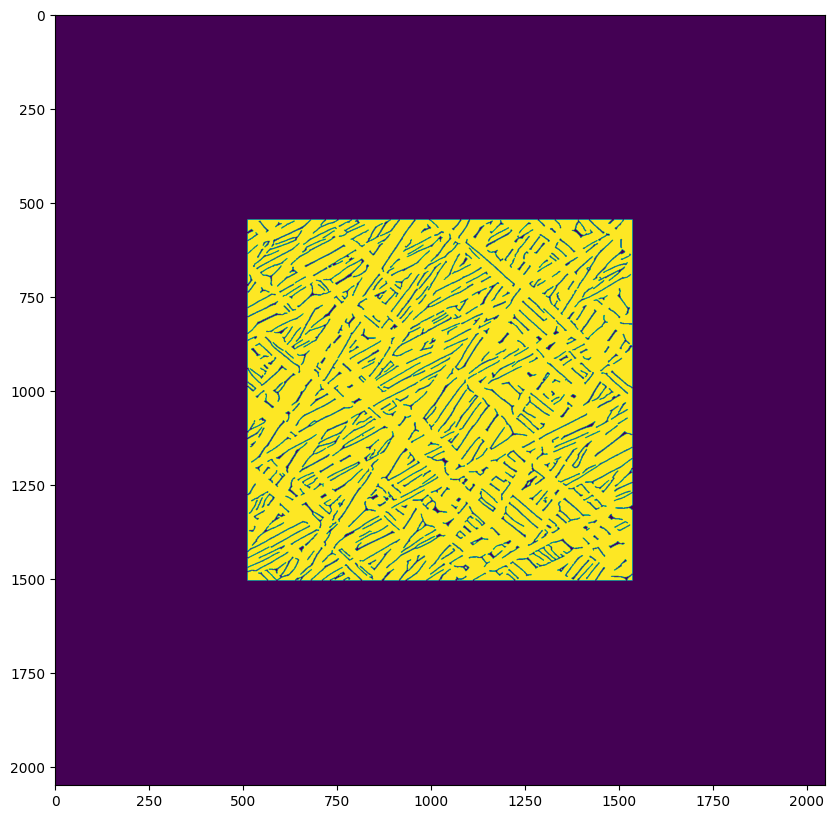

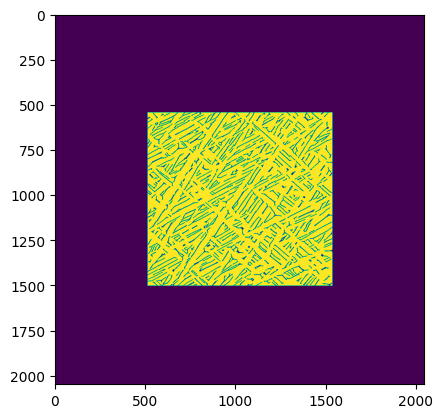

[167  36  29 ...  44  79  14]
24451
The sum of Alpha is : 883892
The Alpha Fraction is : 89.91414388020833
36.1524806740562
0.04599099309320406
Average distance list: [36.1524806740562]
Average distance in pixels for all rotations: 36.1524806740562
Average Inv distance in pixels for all rotations: 0.04599099309320406
Average Area Frac: [89.91414388020833]
The Thickness in um is : 0.7790512592616784
The file name is: image 27.tif
2022-12-01 09:42:02.298099


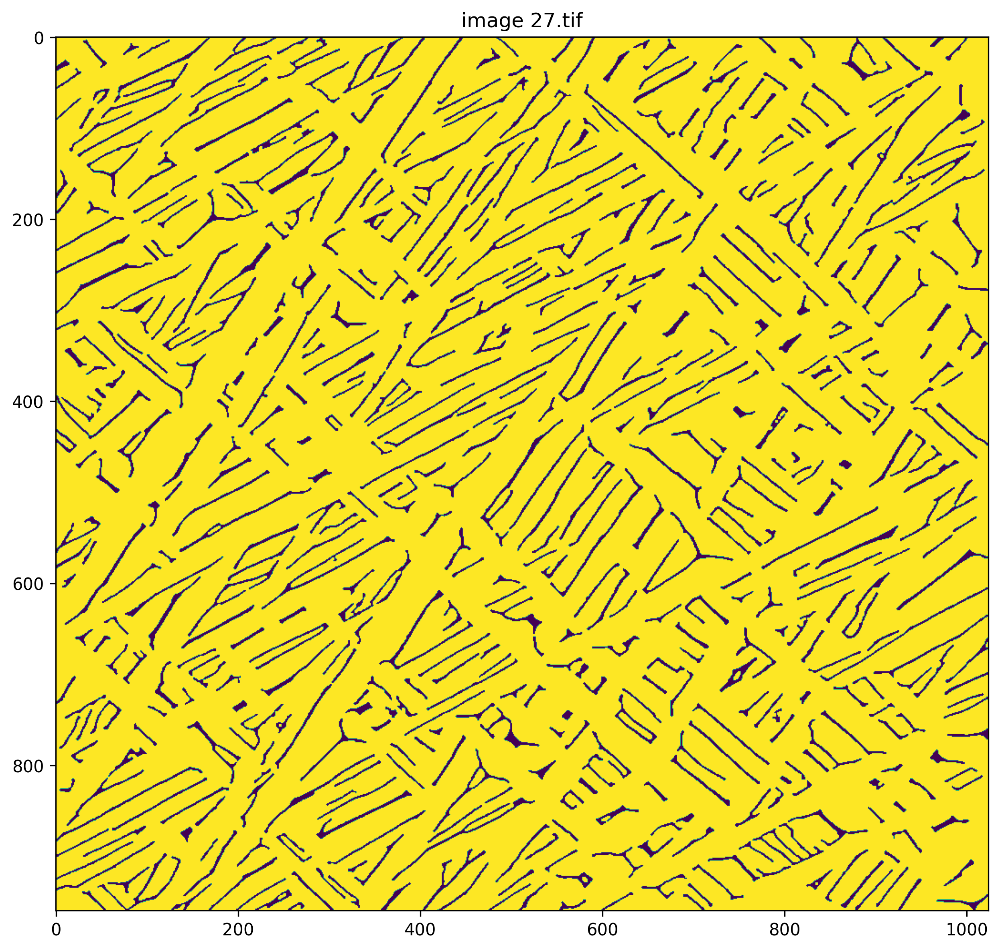

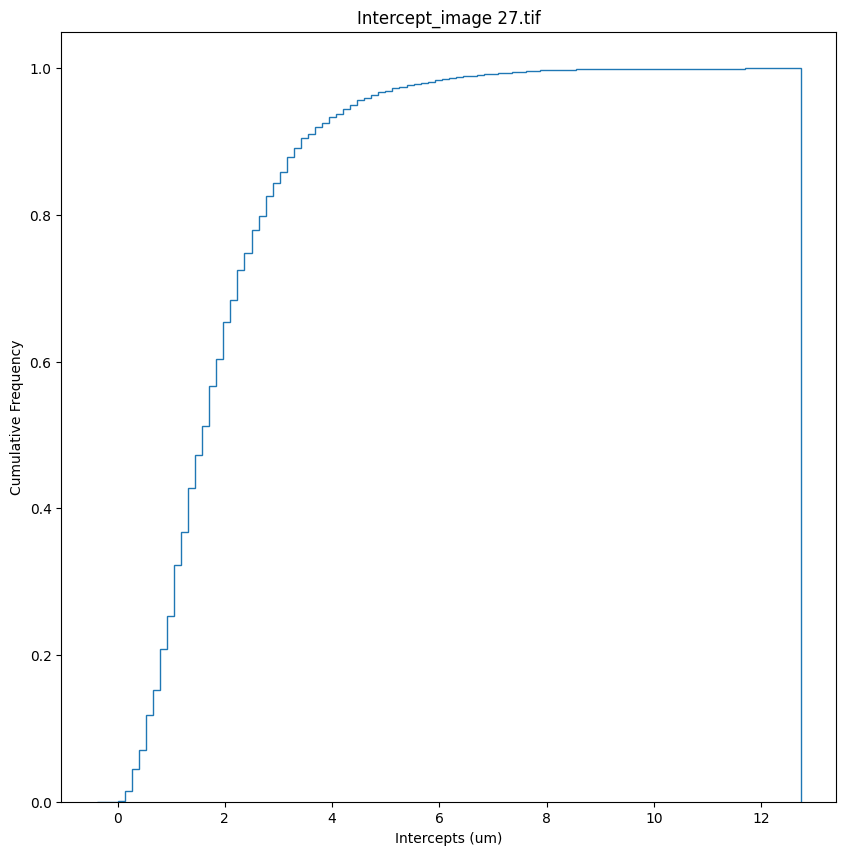

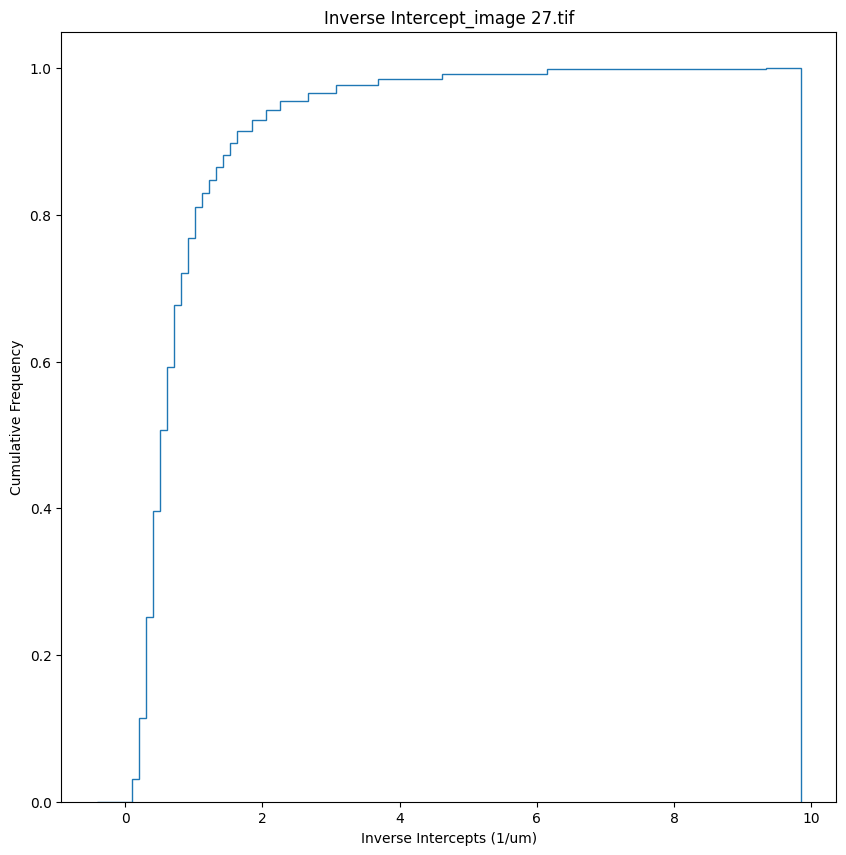

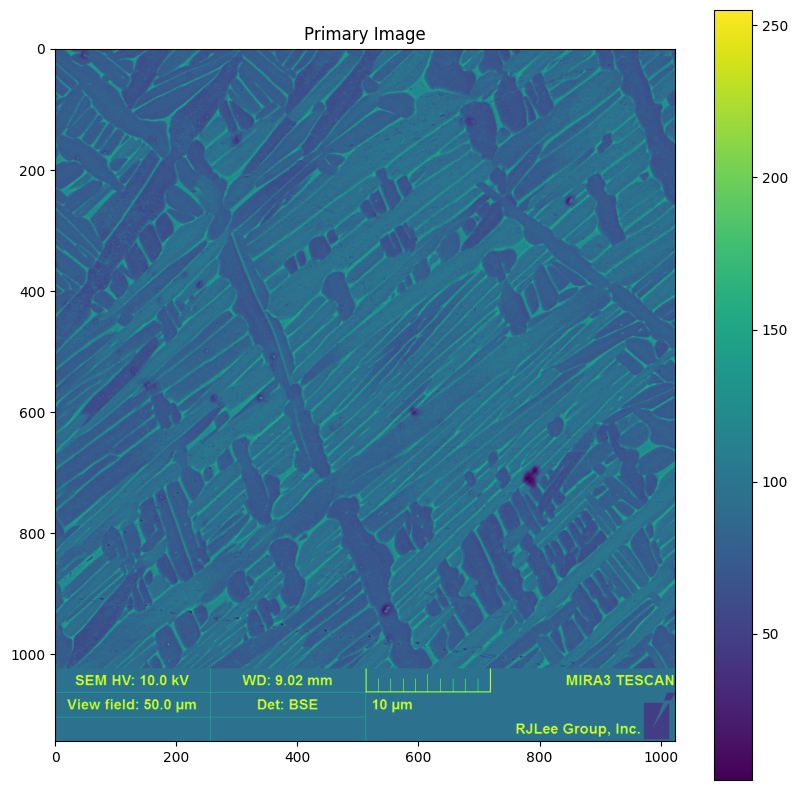

1403.6295807655238


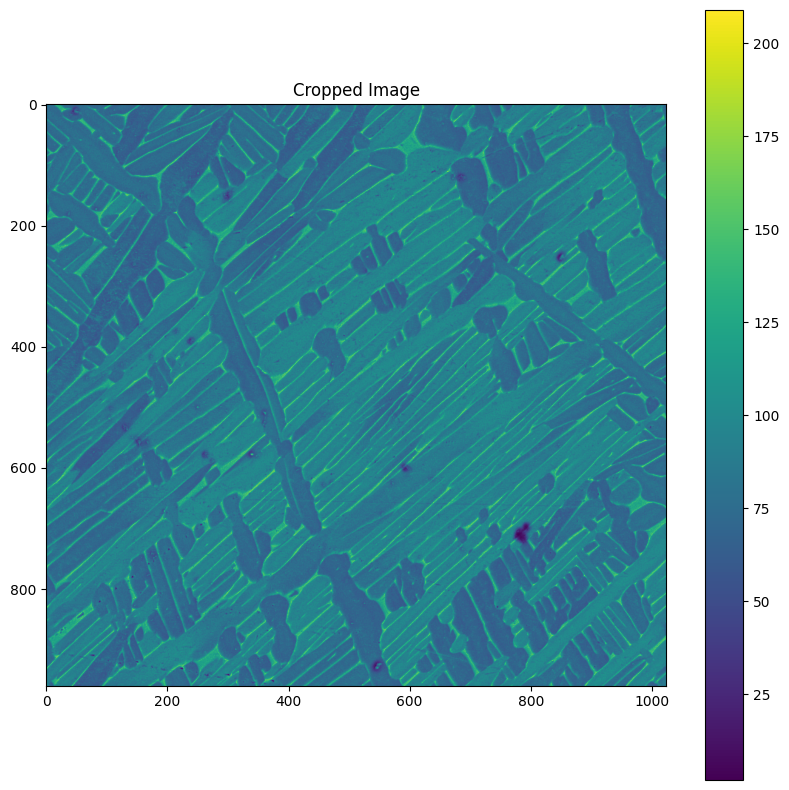

[[ 79  87  85 ...  90  94  76]
 [ 81  77  79 ...  85  73  72]
 [ 72  76  76 ...  75  72  60]
 ...
 [ 97  89 105 ...  72  89 104]
 [ 93  99 108 ...  92 106  99]
 [115 115  87 ...  94 105 110]]
209
2


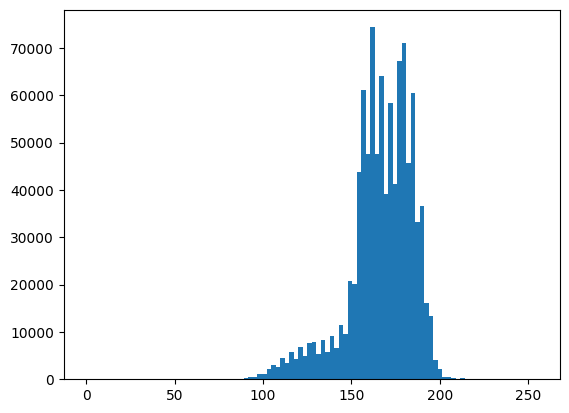

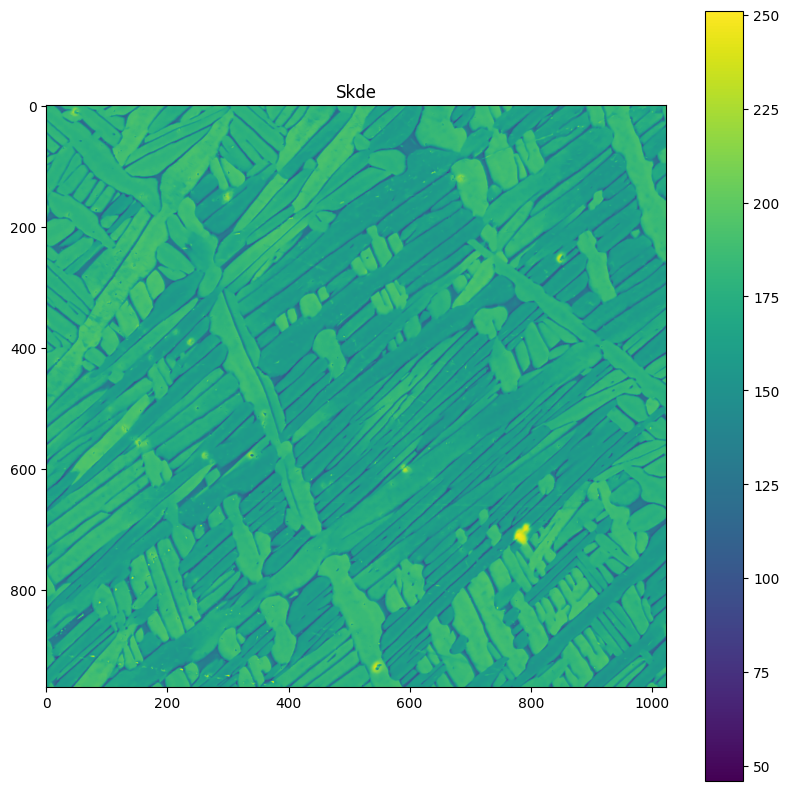

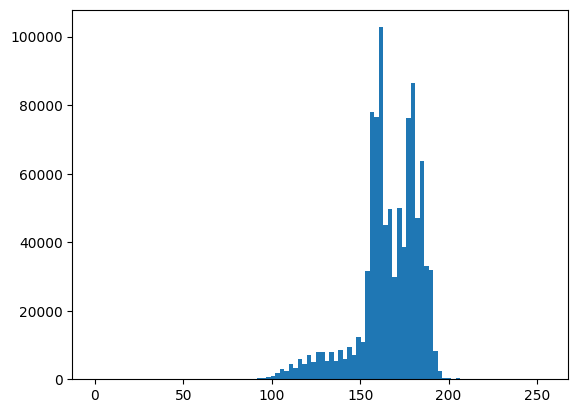

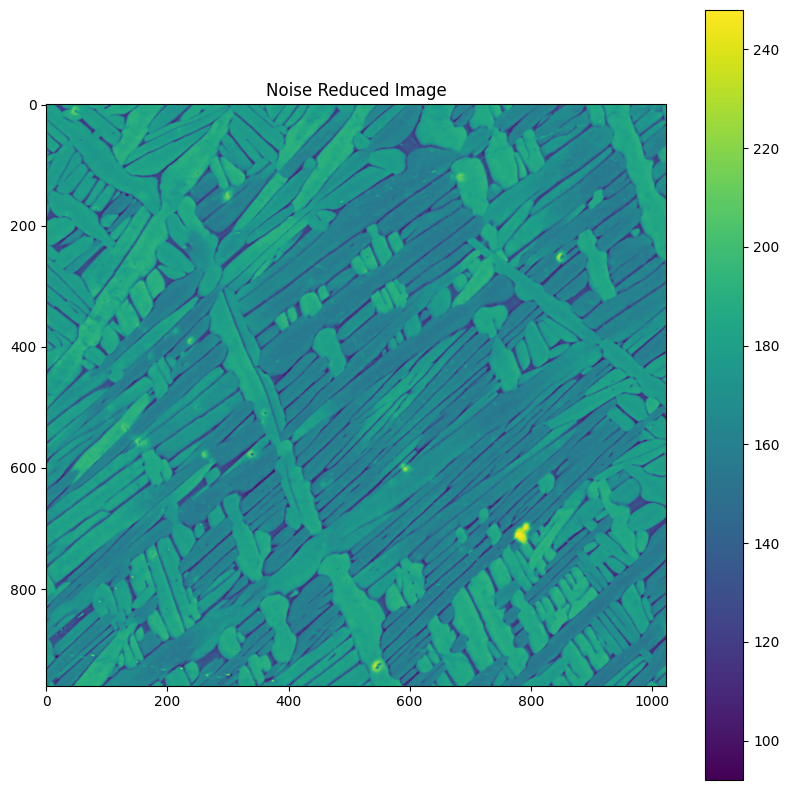

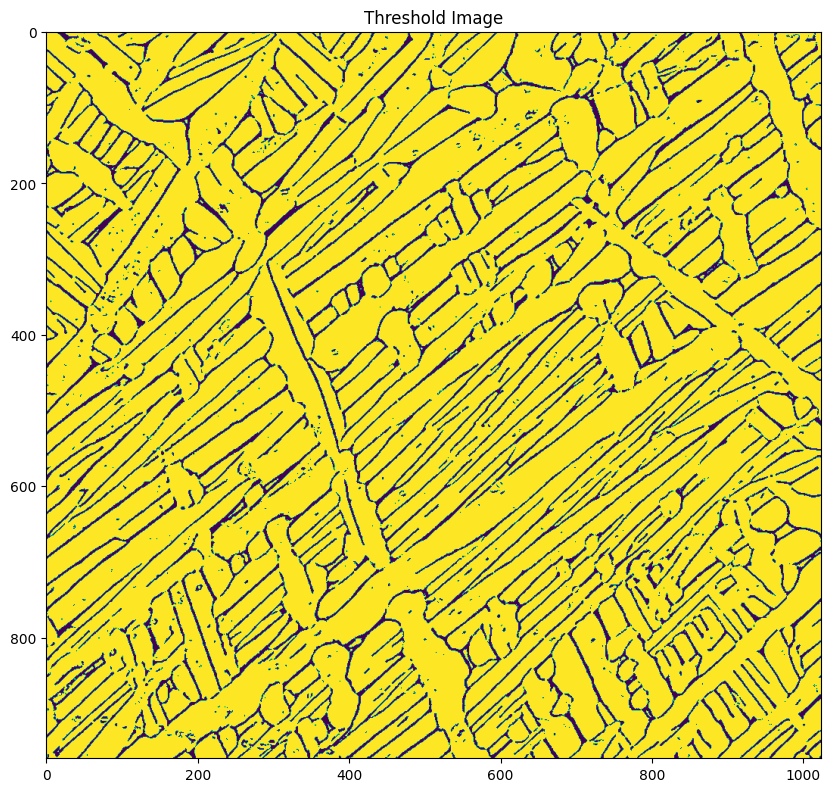

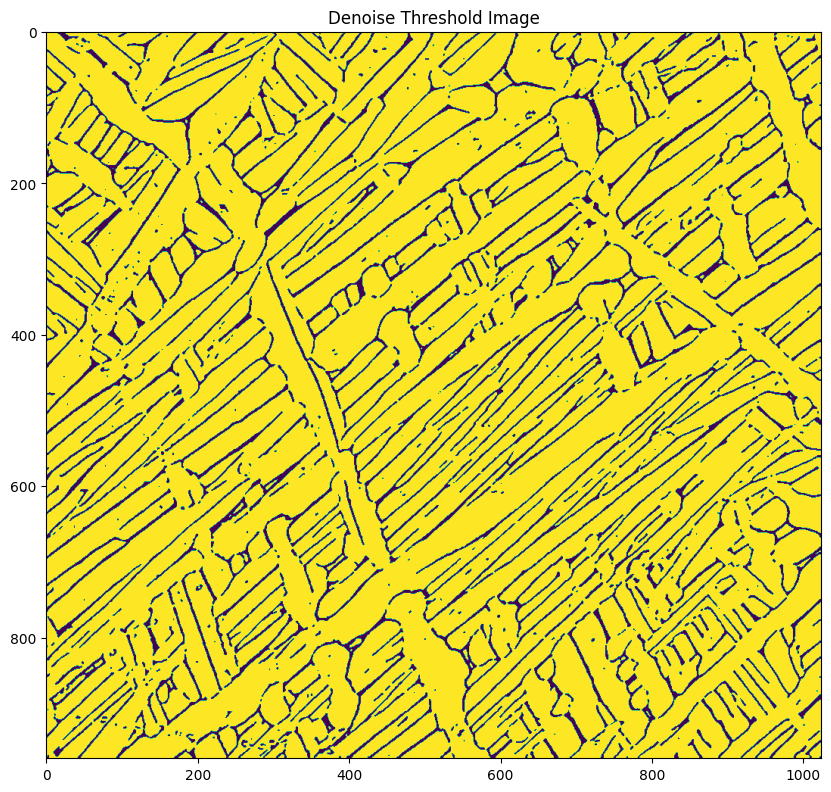

[[1 1 1 ... 0 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 0 ... 1 1 0]
 [1 1 0 ... 1 0 0]
 [0 0 0 ... 1 0 0]]
(960, 1024)
(960, 1024)
[480 512]
983040
1024


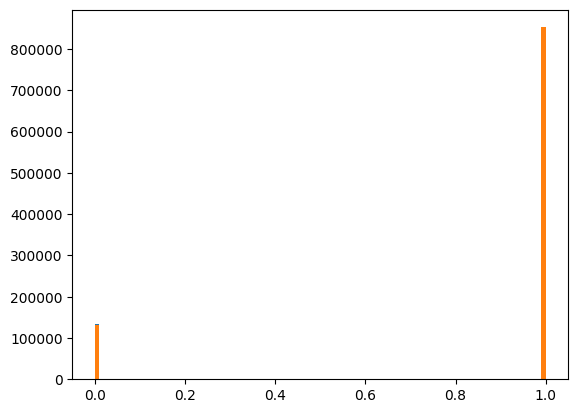

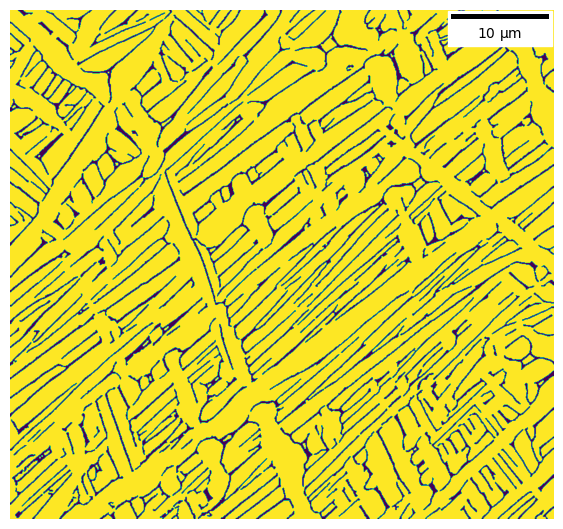

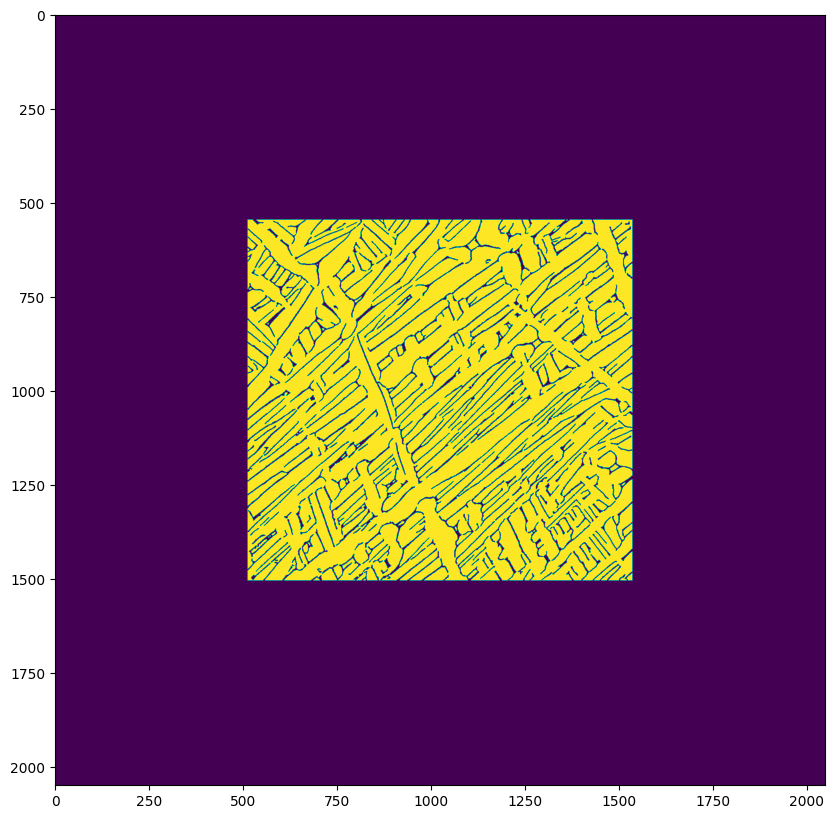

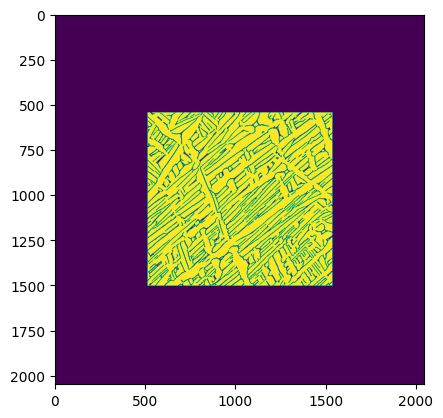

[ 15 128  42 ...  28  18  12]
29673
The sum of Alpha is : 860677
The Alpha Fraction is : 87.55259195963542
29.007347241414177
0.05497902878188446
Average distance list: [29.007347241414177]
Average distance in pixels for all rotations: 29.007347241414177
Average Inv distance in pixels for all rotations: 0.05497902878188446
Average Area Frac: [87.55259195963542]
The Thickness in um is : 0.6516666156887518
The file name is: image 35.tif
2022-12-01 09:43:10.361770


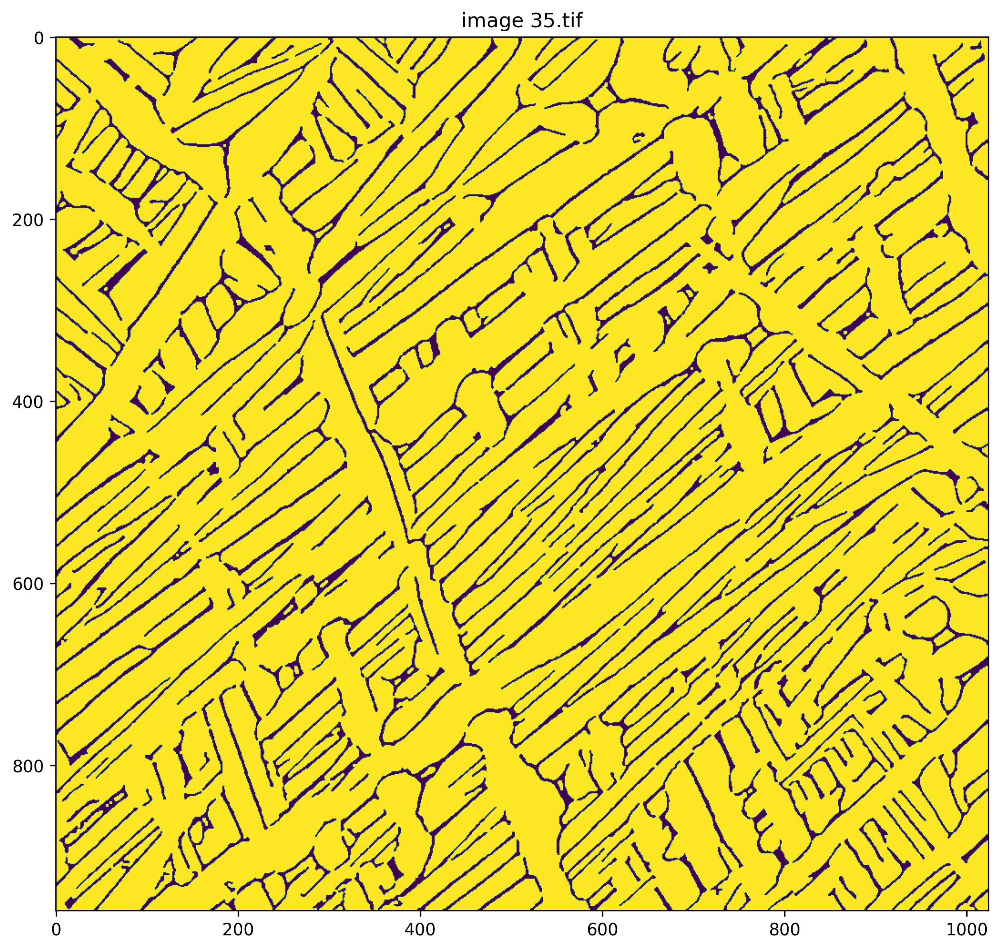

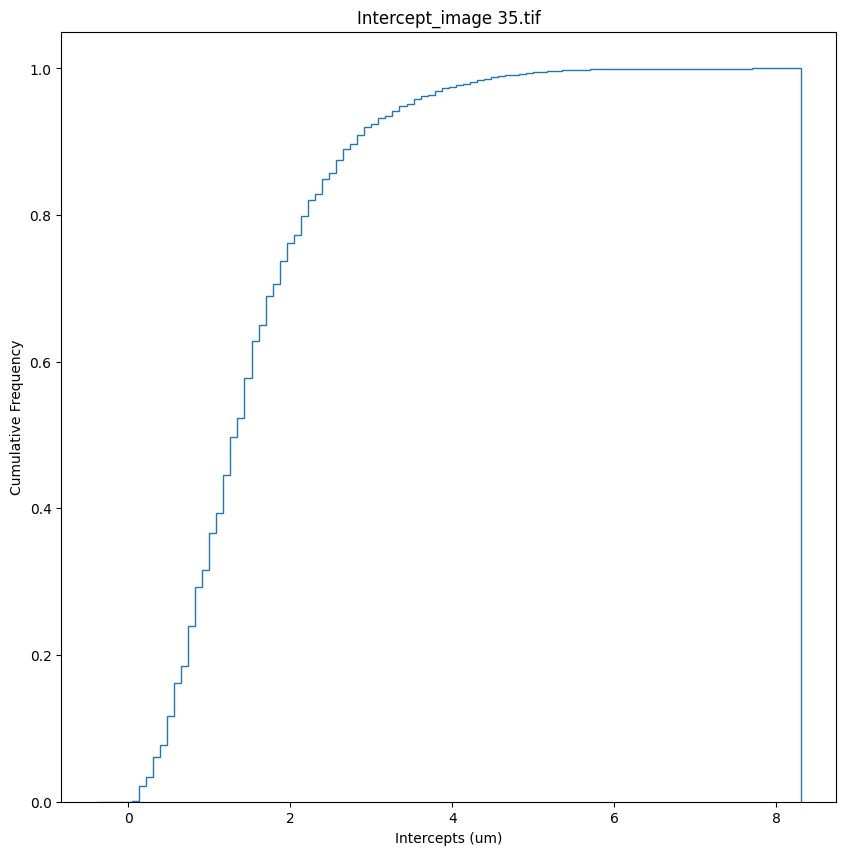

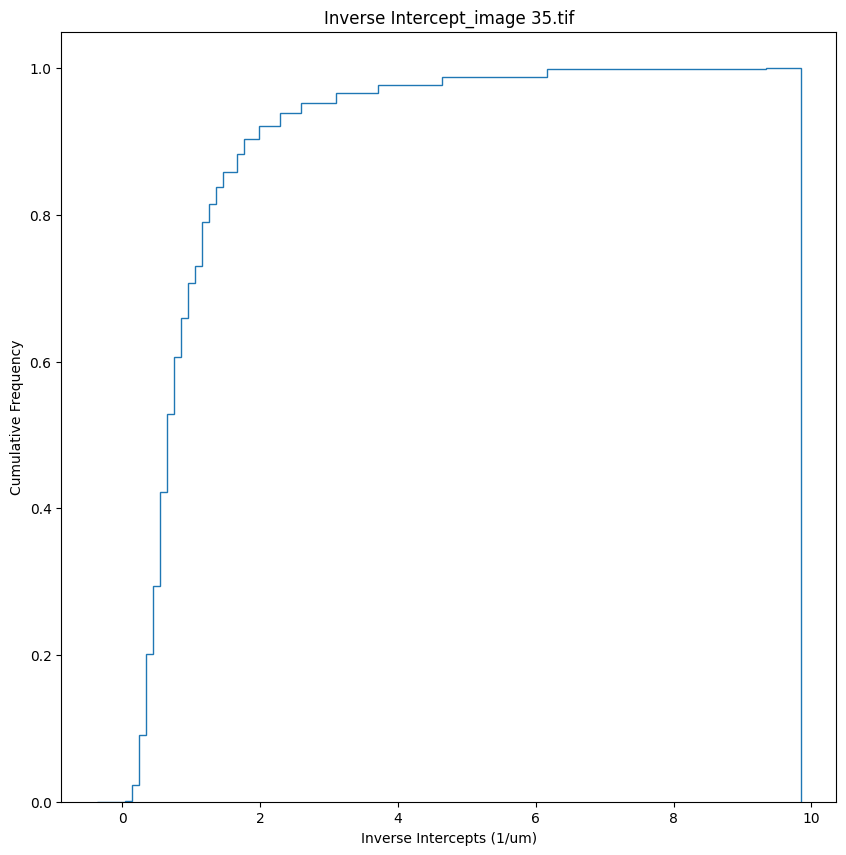

In [15]:
for i in range(len(files)):
    dateTimeObj = datetime.now()

    # Small holes : Remove contiguous holes smaller than the specified size.
    small_holes_connectivity,small_holes_area_threshold=1,64 #64 is default
    nlm,counts,bins,img1_blur,dst,c, d,distance, Inv_distance = measure_lath(path+'/'+files[i],ang_size) # number defines the angle of rotation
    sum_distance=[]
    sum_ind=[]
    avg_beta=[]
    sum_distance1=[]
    sum_ind1=[]
    
    for j in range (len(distance)):
        sum_distance1=sum_distance1+distance[j]
    for k in range (len(Inv_distance)):
        sum_ind1=sum_ind1+Inv_distance[k]   
    sum_distance1=np.array(sum_distance1)	
    

    sum_ind1=np.array(sum_ind1)
    for t in range (len(sum_ind1)):
        if (sum_ind1[t] < 1):
            sum_ind.append(sum_ind1[t])
    for w in range (len(sum_distance1)):
        if (sum_distance1[w] > 1):
            sum_distance.append(sum_distance1[w])
    sum_distance=np.array(sum_distance)	
    sum_ind=np.array(sum_ind)   
    avgdist=np.mean(sum_distance)
    avgind=np.mean(sum_ind)
    plt.figure(figsize=(10,10), dpi=300)
    plt.title(str(files[i]))
    plt.imshow(dst)
    plt.savefig(str(files[i]),dpi= 300 ,format='Tif') #bbox_inches='tight',transparent=True, pad_inches=0
    Thickness=0.67/avgind
    Thick_um=(Thickness*distance_in_micrometer)/distance_in_pixel # the number in the denominator is the distance in pixels from imageJ (Analyse --> Set scale) while the number in numerator is the distance on scale (orginal image scale)
    Thick_table[i] = Thick_um
    mean_intercept[i]=((avgdist*distance_in_micrometer)/distance_in_pixel)#5-171;10-187(5000x)
    #mean_inv_intercept[i]=((InvLamda*186)/10)
    mean_in[i]=((avgind*distance_in_pixel)/distance_in_micrometer)
    #abcd[i]=' '.join(files[i],Thick_table[i])
    frac[i]=c
    sum_distance=(sum_distance*distance_in_micrometer)/distance_in_pixel
    sum_ind=(sum_ind*distance_in_pixel)/distance_in_micrometer
    plt.figure(figsize=(10,10))
    plt.title('Intercept_'+str(files[i]))
    plt.hist(sum_distance, cumulative=True, bins = 100,density = True,  histtype='step',range= ((min(sum_distance)-0.5),(max(sum_distance)+0.5))) 
    plt.xlabel('Intercepts (um)')
    plt.ylabel('Cumulative Frequency')
    plt.savefig('Intercept_'+str(files[i]),dpi= 300 , format='Tif')
    
    plt.figure(figsize=(10,10))
    plt.title('Inverse Intercept_'+str(files[i]))
    plt.hist(sum_ind,bins=100, cumulative=True , density=True, histtype='step',range= ((min(sum_ind)-0.5),(max(sum_ind)+0.5)))
    plt.xlabel('Inverse Intercepts (1/um)')
    plt.ylabel('Cumulative Frequency')
    plt.savefig('Inverse Intercept_'+str(files[i]),dpi= 300 , format='Tif')
	
    images[i]=images.append(files[i]+'~'+str(mean_intercept[i])+'~'+str(mean_in[i])+'~'+str(frac[i])+'~'+str(Thick_table[i])+'~'+str(dateTimeObj))
    print("The Thickness in um is :",Thick_um)
    print("The file name is:",files[i])
    print(dateTimeObj)

In [16]:
print(Thick_table)
# Printing the information to the text file that will contain all the parameters.
Variables = open("Variables_"+Variable_name+" .txt", "w")
Variables.write("Distance in pixels - "+str(distance_in_pixel)+"\n"+"Distance in micrometer scale on SEM image - "+str(distance_in_micrometer)+"\n"+"Threshold_Type - "+Thresholding+"\n"+"Angle Step Size - "+str(ang_size)+"\n"+"Median Blur - "+str(median_filter)+ "\n"+"Adaptive threshold - "+str(adpt_thresh_filter)+","+str(adpt_thresh_const)+"\n"+"Kernal Size - "+"("+str(kernal_a)+","+str(kernal_b)+")"+"\n"+"Denoise - "+"("+str(DeNoise_h)+","+str(DeNoise_template_window_size)+","+str(DeNoise_search_window_size)+")"+"\n"+"Small Objects minimum size - "+str(small_objects_min_size)+"\n"+"Small Holes connectivity - "+str(small_holes_connectivity)+"\n"+"Small Holes area_threshold - "+str(small_holes_area_threshold))
Variables.close()

[0.73392378 0.66443013 0.68552832 0.77905126 0.65166662]


In [17]:
for i in images:
    worksheet.write(row, column, i) 
    row += 1

In [18]:
workbook.close()
time.sleep(1)
end = time.time()
print (f"Total runtime of the program is {end-begin}")

Total runtime of the program is 1730.1178324222565
